In [ ]:
%pip install numpy pandas tqdm lightgbm seaborn matplotlib plotnine scikit-learn

In [ ]:
import os, gc, datetime, time     # os: 운영 체제 관련기능, gc: 가비지 컬렉션
import pandas as pd, numpy as np
from tqdm import tqdm_notebook    # 진행률 표시줄
import lightgbm as lgb
import warnings
warnings.filterwarnings('ignore') # 경고 메세지 무시하도록 설정

pd.set_option('display.max_columns', 500)  # 더 많은 열 표시(500개)
pd.set_option('display.max_rows', 500)     # 더 많은 행 표시(500개)

In [ ]:
# 데이터 시각화를 위해 Seaborn 과 Matplotlib를 설정
# 기본적인 시각화 스타일을 설정, 그래프 크기 16x8 인치로 설정
import seaborn as sns
import matplotlib.pyplot as plt

plt.rcParams['figure.figsize'] = [16, 8] # setting figure size

sns.set()
sns.set_style('whitegrid')
sns.set_color_codes()

In [ ]:
import pickle

import os, sys, gc
from plotnine import *
import plotnine

import seaborn as sns
import warnings
import matplotlib.pyplot as plt
import matplotlib.font_manager as fm
import matplotlib as mpl
from matplotlib import rc
import re
from matplotlib.ticker import PercentFormatter
from sklearn import model_selection, preprocessing, metrics   # Scikit-learn 라이브러리에서 모델 선택, 데이터 전처리, 평가 지표 기능을 임포트
from sklearn.metrics import roc_auc_score                     # roc_auc_score는 ROC AUC 점수를 계산하는 함수

### 데이터 로드

In [ ]:
train_trans = pd.read_csv("/content/drive/MyDrive/Project/train_transaction.csv")
train_idf = pd.read_csv("/content/drive/MyDrive/Project/train_identity.csv")

test_trans = pd.read_csv("/content/drive/MyDrive/Project/test_transaction.csv")
test_idf = pd.read_csv("/content/drive/MyDrive/Project/test_identity.csv")

In [ ]:
test_idf.columns = [c.replace('-', '_') if '-' in c else c for c in test_idf.columns]

In [ ]:
train_trans['TransactionDay'] = train_trans['TransactionDT'] // (24*60*60)
test_trans['TransactionDay'] = test_trans['TransactionDT'] // (24*60*60)

In [ ]:
train_trans.head()

,TransactionID,isFraud,TransactionDT,TransactionAmt,ProductCD,card1,card2,card3,card4,card5,card6,addr1,addr2,dist1,dist2,P_emaildomain,R_emaildomain,C1,C2,C3,C4,C5,C6,C7,C8,C9,C10,C11,C12,C13,C14,D1,D2,D3,D4,D5,D6,D7,D8,D9,D10,D11,D12,D13,D14,D15,M1,M2,M3,M4,M5,M6,M7,M8,M9,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,V11,V12,V13,V14,V15,V16,V17,V18,V19,V20,V21,V22,V23,V24,V25,V26,V27,V28,V29,V30,V31,V32,V33,V34,V35,V36,V37,V38,V39,V40,V41,V42,V43,V44,V45,V46,V47,V48,V49,V50,V51,V52,V53,V54,V55,V56,V57,V58,V59,V60,V61,V62,V63,V64,V65,V66,V67,V68,V69,V70,V71,V72,V73,V74,V75,V76,V77,V78,V79,V80,V81,V82,V83,V84,V85,V86,V87,V88,V89,V90,V91,V92,V93,V94,V95,V96,V97,V98,V99,V100,V101,V102,V103,V104,V105,V106,V107,V108,V109,V110,V111,V112,V113,V114,V115,V116,V117,V118,V119,V120,V121,V122,V123,V124,V125,V126,V127,V128,V129,V130,V131,V132,V133,V134,V135,V136,V137,V138,V139,V140,V141,V142,V143,V144,V145,V146,V147,V148,V149,V150,V151,V152,V153,V154,V155,V156,V157,V158,V159,V160,V161,V162,V163,V164,V165,V166,V167,V168,V169,V170,V171,V172,V173,V174,V175,V176,V177,V178,V179,V180,V181,V182,V183,V184,V185,V186,V187,V188,V189,V190,V191,V192,V193,V194,V195,V196,V197,V198,V199,V200,V201,V202,V203,V204,V205,V206,V207,V208,V209,V210,V211,V212,V213,V214,V215,V216,V217,V218,V219,V220,V221,V222,V223,V224,V225,V226,V227,V228,V229,V230,V231,V232,V233,V234,V235,V236,V237,V238,V239,V240,V241,V242,V243,V244,V245,V246,V247,V248,V249,V250,V251,V252,V253,V254,V255,V256,V257,V258,V259,V260,V261,V262,V263,V264,V265,V266,V267,V268,V269,V270,V271,V272,V273,V274,V275,V276,V277,V278,V279,V280,V281,V282,V283,V284,V285,V286,V287,V288,V289,V290,V291,V292,V293,V294,V295,V296,V297,V298,V299,V300,V301,V302,V303,V304,V305,V306,V307,V308,V309,V310,V311,V312,V313,V314,V315,V316,V317,V318,V319,V320,V321,V322,V323,V324,V325,V326,V327,V328,V329,V330,V331,V332,V333,V334,V335,V336,V337,V338,V339,TransactionDay
0,2987000,0,86400,68.5,W,13926,NaN,150.0,discover,142.0,credit,315.0,87.0,19.0,NaN,NaN,NaN,1.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,2.0,0.0,1.0,1.0,14.0,NaN,13.0,NaN,NaN,NaN,NaN,NaN,NaN,13.0,13.0,NaN,NaN,NaN,0.0,T,T,T,M2,F,T,NaN,NaN,NaN,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,117.0,0.0,0.0,0.0,0.0,0.0,117.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,117.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,117.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1
1,2987001,0,86401,29.0,W,2755,404.0,150.0,mastercard,102.0,credit,325.0,87.0,NaN,NaN,gmail.com,NaN,1.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,1.0,0.0,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,M0,T,T,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0

In [ ]:
"""
train_trans[
    (train_trans['card1'] == 18383) &
    (train_trans['card2'] == 128) &
    (train_trans['card3'] == 150) &
    (train_trans['card4'] == 'visa') &
    (train_trans['card5'] == 226) &
    (train_trans['card6'] == 'credit')
]
"""

train_trans.loc[[232040, 336013, 425671, 511094]][['TransactionID', 'TransactionDT', 'D1', 'D3']]

,TransactionID,TransactionDT,D1,D3
232040,3219040,5504516,449.0,24.0
336013,3323013,8275288,481.0,32.0
425671,3412671,10772608,510.0,29.0
511094,3498094,13378525,540.0,30.0


In [ ]:
for i in range(1, 16):
    if i != 9:
        train_trans[f'D{i}n'] = train_trans['TransactionDay'] - train_trans[f'D{i}']
        test_trans[f'D{i}n'] = test_trans['TransactionDay'] - test_trans[f'D{i}']

In [ ]:
# isFraud가 1인 경우의 card1 값들만 추출
fraud_card1_values = train_trans[train_trans['isFraud'] == 1]['card1']
fraud_card1_values.tail()
# 중복을 제거하고 고유한 card1 값들을 확인하려면:
unique_fraud_card1_values = fraud_card1_values.unique()
unique_fraud_card1_values

fraud_card1_counts = train_trans[train_trans['isFraud'] == 1]['card1'].value_counts().sort_values()
fraud_card1_values

# # NumPy 배열의 전체 출력 설정
# np.set_printoptions(threshold=np.inf)

# # isFraud가 1인 경우의 card1 값들만 추출
# fraud_card1_values = train_trans[train_trans['isFraud'] == 1]['card1']

# # 중복을 제거하고 고유한 card1 값들을 확인
# unique_fraud_card1_values = fraud_card1_values.unique()
# unique_fraud_card1_values

203       18268
240       13413
243       13413
245       13413
288       16578
          ...  
590361     3278
590364     5812
590368     6758
590372    14037
590526     1214
Name: card1, Length: 20663, dtype: int64

In [ ]:
agg = train_trans.groupby(['card1', 'addr1', 'D1n'])['isFraud'].agg({'mean','count'}).reset_index()
agg[agg['mean'] == 1].sort_values(by=['count', 'mean'], ascending=[False, False]).head()

,card1,addr1,D1n,count,mean
185362,17188,122.0,-139.0,84,1.0
146715,13623,498.0,117.0,80,1.0
92234,9002,272.0,-92.0,78,1.0
24959,2939,204.0,-137.0,76,1.0
101019,9749,226.0,-5.0,60,1.0


In [ ]:
agg[(agg['mean'] > 0) & (agg['mean'] != 1)].sort_values(by=['count', 'mean'], ascending=[False, False]).head()

,card1,addr1,D1n,count,mean
137764,12695,325.0,-342.0,123,0.731707
98960,9500,330.0,17.0,83,0.903614
139449,12839,264.0,40.0,59,0.016949
183595,16998,330.0,-37.0,58,0.051724
139445,12839,264.0,36.0,58,0.017241


In [ ]:
train_trans['is_this_transaction_in_test_data'] = 'train'
test_trans['is_this_transaction_in_test_data'] = 'test'
total_trans = pd.concat([train_trans, test_trans], axis=0, sort=False)

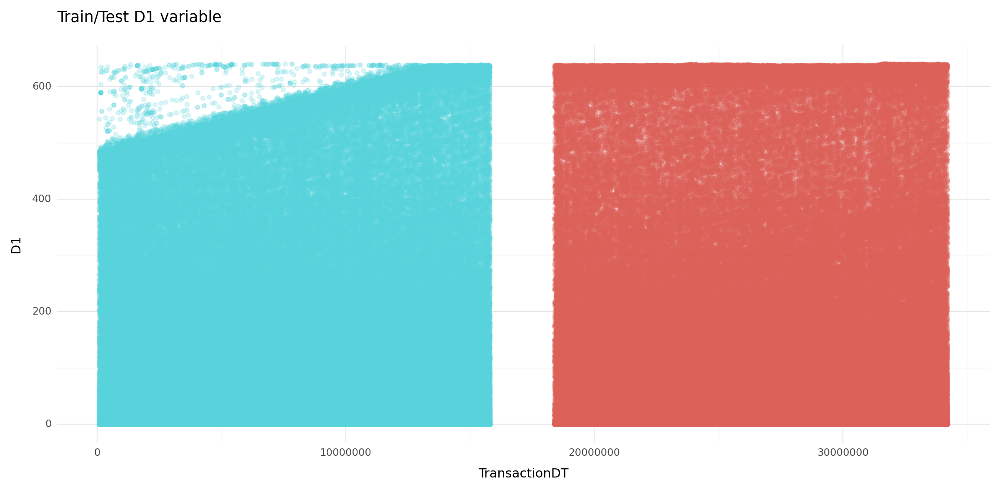

<Figure Size: (1200 x 600)>

In [ ]:
(ggplot(data = total_trans)
     + geom_point(aes(x='TransactionDT', y ='D1', group='is_this_transaction_in_test_data', colour='is_this_transaction_in_test_data'), alpha = 0.2)
     + theme_minimal()
     + ggtitle("Train/Test D1 variable")
     + labs(x = "TransactionDT")
     + theme(legend_position = "none", figure_size=(12,6))
)

## 데이터 병합

In [ ]:
# Data Merge
train_df = pd.merge(train_trans,train_idf,how='left',on='TransactionID')
test_df = pd.merge(test_trans,test_idf,how='left',on='TransactionID')

In [ ]:
train_df.head()

,TransactionID,isFraud,TransactionDT,TransactionAmt,ProductCD,card1,card2,card3,card4,card5,card6,addr1,addr2,dist1,dist2,P_emaildomain,R_emaildomain,C1,C2,C3,C4,C5,C6,C7,C8,C9,C10,C11,C12,C13,C14,D1,D2,D3,D4,D5,D6,D7,D8,D9,D10,D11,D12,D13,D14,D15,M1,M2,M3,M4,M5,M6,M7,M8,M9,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,V11,V12,V13,V14,V15,V16,V17,V18,V19,V20,V21,V22,V23,V24,V25,V26,V27,V28,V29,V30,V31,V32,V33,V34,V35,V36,V37,V38,V39,V40,V41,V42,V43,V44,V45,V46,V47,V48,V49,V50,V51,V52,V53,V54,V55,V56,V57,V58,V59,V60,V61,V62,V63,V64,V65,V66,V67,V68,V69,V70,V71,V72,V73,V74,V75,V76,V77,V78,V79,V80,V81,V82,V83,V84,V85,V86,V87,V88,V89,V90,V91,V92,V93,V94,V95,V96,V97,V98,V99,V100,V101,V102,V103,V104,V105,V106,V107,V108,V109,V110,V111,V112,V113,V114,V115,V116,V117,V118,V119,V120,V121,V122,V123,V124,V125,V126,V127,V128,V129,V130,V131,V132,V133,V134,V135,V136,V137,V138,V139,V140,V141,V142,V143,V144,V145,V146,V147,V148,V149,V150,V151,V152,V153,V154,V155,V156,V157,V158,V159,V160,V161,V162,V163,V164,V165,V166,V167,V168,V169,V170,V171,V172,V173,V174,V175,V176,V177,V178,V179,V180,V181,V182,V183,V184,V185,V186,V187,V188,V189,V190,V191,V192,V193,V194,V195,V196,V197,V198,V199,V200,V201,V202,V203,V204,V205,V206,V207,V208,V209,V210,V211,V212,V213,V214,V215,V216,V217,V218,V219,V220,V221,V222,V223,V224,V225,V226,V227,V228,V229,V230,V231,V232,V233,V234,V235,V236,V237,V238,V239,V240,V241,V242,V243,V244,V245,V246,V247,V248,V249,V250,V251,V252,V253,V254,V255,V256,V257,V258,V259,V260,V261,V262,V263,V264,V265,V266,V267,V268,V269,V270,V271,V272,V273,V274,V275,V276,V277,V278,V279,V280,V281,V282,V283,V284,V285,V286,V287,V288,V289,V290,V291,V292,V293,V294,V295,V296,V297,V298,V299,V300,V301,V302,V303,V304,V305,V306,V307,V308,V309,V310,V311,V312,V313,V314,V315,V316,V317,V318,V319,V320,V321,V322,V323,V324,V325,V326,V327,V328,V329,V330,V331,V332,V333,V334,V335,V336,V337,V338,V339,TransactionDay,D1n,D2n,D3n,D4n,D5n,D6n,D7n,D8n,D10n,D11n,D12n,D13n,D14n,D15n,is_this_transaction_in_test_data,id_01,id_02,id_03,id_04,id_05,id_06,id_07,id_08,id_09,id_10,id_11,id_12,id_13,id_14,id_15,id_16,id_17,id_18,id_19,id_20,id_21,id_22,id_23,id_24,id_25,id_26,id_27,id_28,id_29,id_30,id_31,id_32,id_33,id_34,id_35,id_36,id_37,id_38,DeviceType,DeviceInfo
0,2987000,0,86400,68.5,W,13926,NaN,150.0,discover,142.0,credit,315.0,87.0,19.0,NaN,NaN,NaN,1.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,2.0,0.0,1.0,1.0,14.0,NaN,13.0,NaN,NaN,NaN,NaN,NaN,NaN,13.0,13.0,NaN,NaN,NaN,0.0,T,T,T,M2,F,T,NaN,NaN,NaN,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,117.0,0.0,0.0,0.0,0.0,0.0,117.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,117.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,117.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1,-13.0,NaN,-12.0,NaN,NaN,NaN,NaN,NaN,-12.0,-12.0,NaN,NaN,NaN,1.0,train,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Na

In [ ]:
from sklearn.preprocessing import LabelEncoder

for col in tqdm_notebook(train_df.columns):
    if train_df[col].dtype == 'object':
        le = LabelEncoder()
        le.fit(list(train_df[col].astype(str).values) + list(test_df[col].astype(str).values))
        train_df[col] = le.transform(list(train_df[col].astype(str).values))
        test_df[col] = le.transform(list(test_df[col].astype(str).values))

  0%|          | 0/450 [00:00<?, ?it/s]

In [ ]:
id_feature = [ c for c in train_df.columns if c.find('id_') !=-1]
v_feature = [ c for c in train_df.columns if c.find('V') !=-1]
card_feature = [ c for c in train_df.columns if c.find('card') !=-1]
C_feature = [ c for c in train_df.columns if c.find('C') !=-1 and c != 'ProductCD']
D_feature = [ c for c in train_df.columns if c.find('n') == -1 and c.find('D') !=-1 and c not in ['ProductCD','TransactionID','TransactionDT','DeviceType','DeviceInfo','TransactionDay']]
Dn_feature = [ c for c in train_df.columns if c.find('n') != -1 and c.find('D') !=-1 and c not in ['ProductCD','TransactionID','TransactionDT','DeviceType','DeviceInfo','TransactionDay']]
M_feature = [ c for c in train_df.columns if c.find('M') !=-1]

In [ ]:
total_df = pd.concat([train_df, test_df], axis=0, sort=False)
target = total_df['is_this_transaction_in_test_data'].values
train, test = model_selection.train_test_split(total_df, test_size=0.33, random_state=42, shuffle=True)

train_y = train['is_this_transaction_in_test_data'].values
test_y = test['is_this_transaction_in_test_data'].values

# TransactionDT ~ M columns
features = np.append(['TransactionDT', 'TransactionAmt', 'ProductCD'], card_feature + Dn_feature + C_feature + M_feature)
train_ = lgb.Dataset(train[features], label=train_y)
test_ = lgb.Dataset(test[features], label=test_y)

In [ ]:
total_df = pd.concat([train_df, test_df], axis=0, sort=False)
target = total_df['is_this_transaction_in_test_data'].values

In [ ]:
train, test = model_selection.train_test_split(total_df, test_size=0.33, random_state=42, shuffle=True)

train_y = train['is_this_transaction_in_test_data'].values
test_y = test['is_this_transaction_in_test_data'].values

# TransactionDT ~ M columns
features = np.append(['TransactionDT', 'TransactionAmt', 'ProductCD'], card_feature + Dn_feature + C_feature + M_feature)
train_ = lgb.Dataset(train[features], label=train_y)
test_ = lgb.Dataset(test[features], label=test_y)

`features 형태`   
array(['TransactionDT', 'TransactionAmt', 'ProductCD', 'card1', 'card2',   
       'card3', 'card4', 'card5', 'card6', 'D1n', 'D2n', 'D3n', 'D4n',   
       'D5n', 'D6n', 'D7n', 'D8n', 'D10n', 'D11n', 'D12n', 'D13n', 'D14n',   
       'D15n', 'C1', 'C2', 'C3', 'C4', 'C5', 'C6', 'C7', 'C8', 'C9',   
       'C10', 'C11', 'C12', 'C13', 'C14', 'M1', 'M2', 'M3', 'M4', 'M5',   *이탤릭체 텍스트*
       'M6', 'M7', 'M8', 'M9'], dtype='<U14')

In [ ]:
# 문제점
# 파라미터에 따라서 아래와 결과가 달라짐.
# AutoML 돌린거임
params = {'num_leaves': 491,
          'min_child_weight': 0.03454472573214212,
          'feature_fraction': 0.3797454081646243,
          'bagging_fraction': 0.4181193142567742,
          'min_data_in_leaf': 106,
          'objective': 'binary',
          'max_depth': -1,
          'learning_rate': 0.006883242363721497,
          "boosting_type": "gbdt",
          "bagging_seed": 11,
          "metric": 'auc',
          "verbosity": -1,
          'reg_alpha': 0.3899927210061127,
          'reg_lambda': 0.6485237330340494,
          'random_state': 47
         }

In [ ]:
num_round = 50
#clf = lgb.train(params, train_, num_round, valid_sets = [train_, test_], verbose_eval=50, early_stopping_rounds = 50)
clf = lgb.train(
    params,
    train_,
    num_round,
    valid_sets=[train_, test_],
    callbacks=[
        lgb.early_stopping(stopping_rounds=50),
        lgb.log_evaluation(period=50)
    ]
)

Training until validation scores don't improve for 50 rounds
[50]	training's auc: 0.999999	valid_1's auc: 0.999998
Did not meet early stopping. Best iteration is:
[21]	training's auc: 1	valid_1's auc: 0.999999


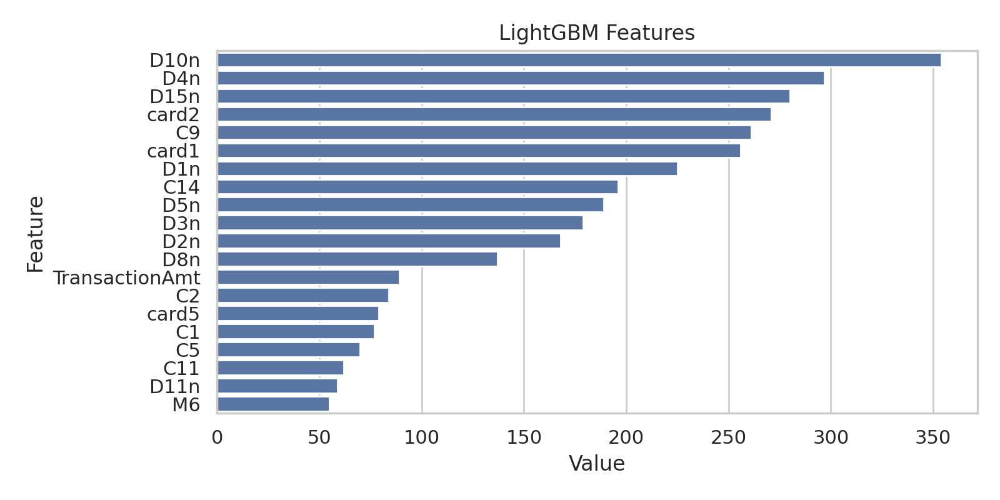

<Figure size 1600x800 with 0 Axes>

In [ ]:
feature_imp = pd.DataFrame(sorted(zip(clf.feature_importance(),features)), columns=['Value','Feature'])

plt.figure(figsize=(8, 4))
sns.barplot(x="Value", y="Feature", data=feature_imp.sort_values(by="Value", ascending=False).head(20))
plt.title('LightGBM Features')
plt.tight_layout()
plt.show()
plt.savefig('lgbm_importances-01.png')

In [ ]:
# TransactionDT ~ M columns
features = v_feature
train_ = lgb.Dataset(train[features], label=train_y)
test_ = lgb.Dataset(test[features], label=test_y)

num_round = 50
# LightGBM 모델 학습
clf = lgb.train(
    params,
    train_,
    num_round,
    valid_sets=[train_, test_],
    callbacks=[
        lgb.early_stopping(stopping_rounds=50),
        lgb.log_evaluation(period=50)
    ]
)

Training until validation scores don't improve for 50 rounds
[50]	training's auc: 0.760906	valid_1's auc: 0.752283
Did not meet early stopping. Best iteration is:
[50]	training's auc: 0.760906	valid_1's auc: 0.752283


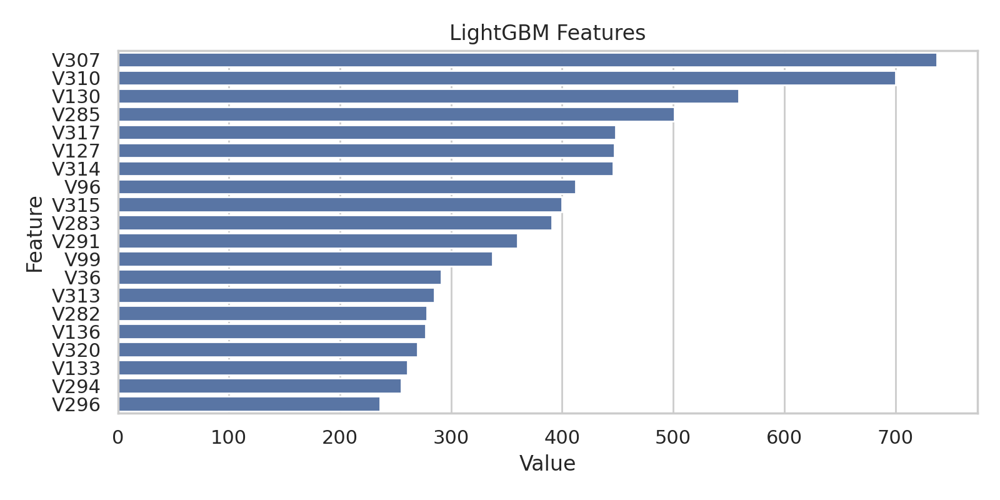

<Figure size 1600x800 with 0 Axes>

In [ ]:
feature_imp = pd.DataFrame(sorted(zip(clf.feature_importance(),features)), columns=['Value','Feature'])

plt.figure(figsize=(8, 4))
sns.barplot(x="Value", y="Feature", data=feature_imp.sort_values(by="Value", ascending=False).head(20))
plt.title('LightGBM Features')
plt.tight_layout()
plt.show()
plt.savefig('lgbm_importances-02.png')

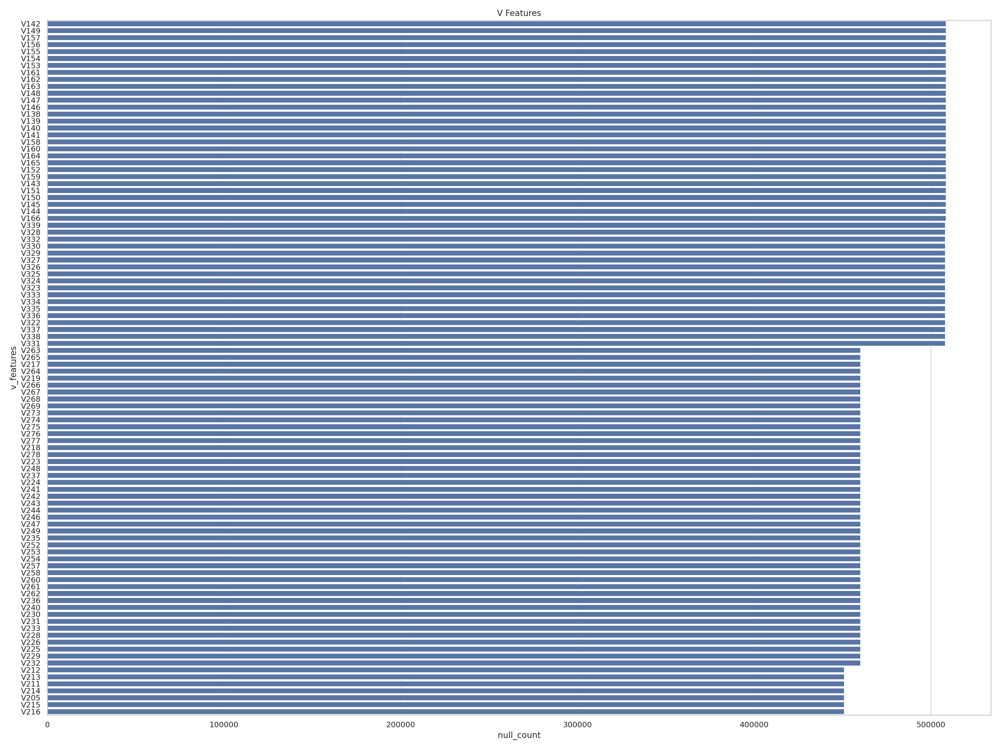

<Figure size 1600x800 with 0 Axes>

In [ ]:
nullsum = pd.DataFrame(train_df[v_feature].isnull().sum()).reset_index()
nullsum.columns = ['v_features', 'null_count']

plt.figure(figsize=(20, 15))
sns.barplot(x="null_count", y="v_features", data=nullsum.sort_values(by="null_count", ascending=False).head(100))
plt.title('V Features')
plt.tight_layout()
plt.show()
plt.savefig('Null Count-03.png')

---

## < **Feature Engineering** >

In [ ]:
# Data Merge
X_train = pd.merge(train_trans,train_idf,how='left',on='TransactionID')
X_test = pd.merge(test_trans,test_idf,how='left',on='TransactionID')

## FREQUENCY ENCODE TOGETHER
- Frequency Encode란 범주형 변수를 범주의 빈도로 변환해주는 인코딩 과정을 의미한다.
- 데이터의 분포와 특성을 유지하면서도 모델이 이해할 수 있는 형식으로 데이터를 제공하는 것을 목표로 함

In [ ]:
def encode_FE(df1, df2, cols):
    # X_train과 X_test를 받아줄 df1, df2 그리고 그에 해당하는 열(cols)을 입력받아 반복문을 돌린다.
    for col in cols:
        # df1과 df2의 해당 열들을 하나의 데이터 프레임으로 합친다, df1과 df2의 col 열을 합쳐서 하나의 시리즈로 만듬
        df = pd.concat([df1[col],df2[col]])

        # vc라는 변수에 df 전체 빈도수의 비율을 {값:비율} 형태로 저장한다.
        # 각 값의 빈도를 계산하고 이를 딕셔너리 형태로 변환합니다.
        # dropna=True는 NaN 값을 무시합니다.
        # normalize=True는 빈도를 비율로 나타냅니다.
        vc = df.value_counts(dropna=True, normalize=True).to_dict()

        # vc에 존재하지 않는 값을 처리하기 위해, vc 딕셔너리에 -1 을 추가한다.
        #   ㄴ 위에 dropna=True로 인해 NaN 값은 계산에서 제외되지만, 여전히 df1 과 df2 에는 NaN 값이 존재할 수 있기때문에
        vc[-1] = -1

        # 새로운 열을 정의함 -> 예를 들어 col 이 'A' 라면 'A_FE' 가 된다
        nm = col+'_FE'

        # map(): 여러 개의 반복 가능한(iterable) 객체를 입력으로 받아서 여러 개의 데이터를 동시에 처리
        # df1의 새로운 열(nm)에 각 값이 vc 를 통해 빈도로 매핑된 값을 담아줌
        df1[nm] = df1[col].map(vc)

        # astype ('float32')로 변환하여 메모리 사용을 최적화 해줌
        df1[nm] = df1[nm].astype('float32')

        # df2 에서도 동일한 작업 수행
        df2[nm] = df2[col].map(vc)
        df2[nm] = df2[nm].astype('float32')

        # 진행 상황 출력
        print(nm,', ',end='')



####목적
- 빈도 기반 인코딩(Frequency Encoding): 카테고리형 변수를 각 값의 빈도로 변환하여 숫자형 데이터로 변환합니다.
- 결측치 및 예외 값 처리: vc[-1] = -1을 통해 NaN 값이나 빈도 딕셔너리에 없는 값을 일관되게 처리합니다.    
####이유
- 모델 호환성: 머신러닝 모델은 숫자형 데이터를 필요로 하므로 카테고리형 변수를 숫자로 변환합니다.
- 빈도 정보 활용: 각 값의 빈도를 인코딩하여 데이터셋에서 중요한 정보를 모델에 제공할 수 있습니다.
- 결측치 처리: 빈도 계산에서 제외된 NaN 값이 여전히 데이터프레임에 존재할 수 있기 때문에, 이를 명확하게 처리하기 위해 -1로 설정합니다.
####이점
- 모델 성능 향상: 원-핫 인코딩보다 차원이 줄어들어 메모리 효율적이고, 빈도가 중요한 정보로 사용되어 모델 성능을 향상시킬 수 있습니다.
- 일관된 예외 처리: NaN 값이나 존재하지 않는 값을 일관되게 처리하여 예측 모델의 안정성을 높입니다.

## Frequency Encode 이점

####  1. 모델의 성능 향상
- 빈도 기반의 인코딩: 범주형 변수를 빈도로 변환하면, 데이터의 분포와 특성을 더 잘 반영할 수 있습니다. 이는 모델이 해당 변수를 더 잘 이해하고 처리하게 도와줍니다.
- 유용한 정보 제공: 범주형 변수의 빈도는 그 변수의 중요도를 나타낼 수 있습니다. 예를 들어, 빈도가 높은 값은 더 일반적이므로 모델이 이를 더 중요하게 고려할 수 있습니다.
####2. 메모리 사용 최적화
- 효율적인 데이터 타입 변환: Frequency Encoding 과정에서 데이터 타입을 float32로 변환하면, 메모리 사용을 최적화할 수 있습니다. 이는 특히 대용량 데이터셋에서 유리합니다.
- 결측값 처리: 결측값을 빈도의 일부로 포함하거나 별도로 처리하여, 모델이 이를 적절히 다루게 할 수 있습니다.
####3. 간단하고 빠른 인코딩
- 간단한 구현: Frequency Encoding은 비교적 간단한 방법으로 구현할 수 있으며, 범주형 변수를 수치형으로 변환하는 데 효율적입니다.
- 빠른 처리: 다른 인코딩 방법에 비해 계산 비용이 낮아, 대용량 데이터셋에서도 빠르게 처리할 수 있습니다.
####4. 모델의 해석 용이성
- 빈도 기반의 해석: 인코딩된 값이 실제 데이터의 빈도를 반영하므로, 모델의 예측 결과를 해석하는 데 도움이 됩니다. 예를 들어, 빈도가 높은 범주가 모델의 예측에 더 큰 영향을 미쳤는지 쉽게 이해할 수 있습니다.
####5. 범주형 변수의 특성 반영
- 범주의 중요도 반영: 빈도가 높은 범주는 더 일반적이므로, 이를 통해 범주형 변수의 중요도를 모델이 더 잘 반영할 수 있습니다

## 라벨 인코딩 (Label Encoding)
- 문자열로 된 범주형 변수를 코드형 숫자 값으로 변환하는 것

In [ ]:
# col: 인코딩할 열의 이름, 기본값은 X_train, X_test 로 하고
# verbose: 함수 실행 중 진행 상황을 출력할지 여부를 지정하는 불리언 값 기본값은 True
def encode_LE(col,train=X_train,test=X_test,verbose=True):

    # train과 test의 col열을 행을 기준으로 합쳐서 하나의 시리즈로 만듬
    # 라벨 인코딩을 train과 test 데이터프레임 모두에게 일관되게 수행하기 위해서
    df_comb = pd.concat([train[col],test[col]],axis=0)

    # 각 값에 대해 고유 번호를 부여
    # 카테고리형 변수를 고유 번호로 변환하기 위해
    df_comb,_ = df_comb.factorize(sort=True)

    # 새로운 열 이름을 기존 열 이름과 동일하게 설정
    nm = col

    # 인코딩된 값의 최댓값 32000보다 클 경우, int32로 변환합니다.
    # 인코딩된 값이 큰 경우 'int16' 데이터 타입을 사용불가해서 'int32'로 변환
    if df_comb.max()>32000:
        train[nm] = df_comb[:len(train)].astype('int32')
        test[nm] = df_comb[len(train):].astype('int32')

    # 만일 인코딩 된 값의 크기가 32000보다 작다면 int16 Dtype으로 변환한다. -> 메모리 효율성
    else:
        train[nm] = df_comb[:len(train)].astype('int16')
        test[nm] = df_comb[len(train):].astype('int16')

    # 결합된 데이터프레임을 삭제하고 메모리를 회수합니다 -> 더이상 필요없는 데이터 삭제
    del df_comb

    # 가비지 컬렉터를 호출하여 메모리를 회수합니다.
    # 메모리 관리의 효율성을 높이기 위해 명시적으로 가비지 컬렉션을 실행
    x=gc.collect()

    # verbose가 True일 경우, 인코딩이 완료된 열 이름을 출력합니다.
    # 만일 verbose 옵션이 True라면, '열의 이름'과 쉼표를 출력하되 줄바꿈 없이 출력합니다.
    if verbose: print(nm,', ',end='')

## 그룹 집계 평균 및 표준편차
- **표준편차** : 분산을 제곱근한 것이다. 편차들(deviations)의 제곱합(SS, sum of square)에서 얻어진 값의 평균치인 분산의 성질로부터 다시 제곱근해서 원래 단위로 만들어줌으로써 얻게된다.
(GROUP AGGREGATION MEAN AND STD)

### < 매개 변수 설명 >
- main_columns: 집계할 주요 열들의 리스트.
- uids: 그룹화할 UID 열들의 리스트, 고객의 아이디를 의미하는 변수 / ex) ['card1', 'card2'] 등
- aggregations: 계산할 통계량의 리스트. 기본값은 ['mean'].
- train_df: 훈련 데이터프레임.
- test_df: 테스트 데이터프레임.
- fillna: 결측값을 -1로 채울지 여부. 기본값은 True.
- usena: 특정 값(-1)을 NaN으로 처리할지 여부. 기본값은 False.

In [ ]:
# GROUP AGGREGATION MEAN AND STD
def encode_AG(main_columns, uids, aggregations=['mean'], train_df=X_train, test_df=X_test, fillna=True, usena=False):
    # AGGREGATION OF MAIN WITH UID FOR GIVEN STATISTICS
    # main_columns 리스트에 있는 각 열에 대해 반복
    for main_column in main_columns:
        # uids 리스트에 있는 각 열에 대해 반복
        for col in uids:
            # aggregations 리스트에 있는 각 연산에 대해 반복
            for agg_type in aggregations:
                # 새로운 열 이름을 정의합니다. 예: '통계에쓸컬럼_그룹컬럼_연산'
                new_col_name = main_column + '_' + col + '_' + agg_type
                # train_df와 test_df에서 col 및 main_column 열을 가져와서 합친 후, temp_df에 저장합니다.
                temp_df = pd.concat([train_df[[col, main_column]], test_df[[col, main_column]]])

                # usena가 True인 경우, main_column에서 값이 -1인 부분을 NaN으로 변경합니다.
                if usena:
                    temp_df.loc[temp_df[main_column] == -1, main_column] = np.nan

                # col 열을 기준으로 main_column에 대해 agg_type 연산을 수행한 후, 새로운 열 이름을 new_col_name으로 지정합니다.
                temp_df = temp_df.groupby([col])[main_column].agg([agg_type]).reset_index().rename(
                    columns={agg_type: new_col_name})

                # temp_df의 인덱스를 col 열의 값으로 설정합니다.
                temp_df.index = list(temp_df[col])
                # 새로운 열을 딕셔너리 형태로 변환합니다.
                temp_df = temp_df[new_col_name].to_dict()

                # train_df와 test_df에 새로운 열을 추가하고, col 열을 기준으로 temp_df 딕셔너리를 매핑합니다.
                train_df[new_col_name] = train_df[col].map(temp_df).astype('float32')
                test_df[new_col_name] = test_df[col].map(temp_df).astype('float32')

                # fillna가 True인 경우, NaN 값을 -1로 대체합니다.
                if fillna:
                    train_df[new_col_name].fillna(-1, inplace=True)
                    test_df[new_col_name].fillna(-1, inplace=True)

                # 새로운 열 이름을 출력합니다.
                print("'" + new_col_name + "'", ', ', end='')

위 코드는
- 데이터프레임에서 특정 열들을 그룹화하여 통계 값을 계산하고, 그 결과를 새로운 열로 추가하는 작업을 수행
- 이러한 그룹화 및 통계 값 계산은 주로 피처 엔지니어링의 일환으로, 모델의 성능을 향상시키기 위해 사용

In [ ]:
# COMBINE FEATURES
# 두 열의 이름을 붙여 새로운 열 만들기
def encode_CB(col1,col2,df1=X_train,df2=X_test):
    # nm = ["기존열1_기존열2"]
    nm = col1+'_'+col2
    # df1의 col1과 col2의 요소를 문자열로 변환한 후, '_'를 넣어 결합한 값을 df1[nm]에 담아준다.
    df1[nm] = df1[col1].astype(str) + '_' + df1[col2].astype(str)
    # df2도 같은 과정을 통해 새 열을 생성한다.
    df2[nm] = df2[col1].astype(str) + '_' + df2[col2].astype(str)

    # 그 후에 df1, df2의 nm 열을 라벨 인코딩 처리해준다.
    encode_LE(nm, verbose=False)

    # 결과로 "기존열1_기존열2", 이런 식으로 줄간격 없이 출력하게 된다.
    print(nm, ', ', end='')

- 해당 함수는 두 개의 열을 합하여 새로운 피처(컬럼)을 생성하고, 이를 라벨 인코딩을 통해 숫자 레이블로 변환하여 모델 학습에 사용할 수 있게 해줍니다.

- 이를 통해, 데이터의 다양한 조합을 시도하고 표현할 수 있어, 모델의 성능을 향상시킬 수 있습니다.

In [ ]:
# GROUP AGGREGATION NUNIQUE
def encode_AG2(main_columns, uids, train_df=X_train, test_df=X_test):
    # 메인 컬럼들 중 하나 씩 가져오고
  for main_column in main_columns:
      # 사용자 식별 컬럼들도 마찬가지로 하나씩 가져옵니다.
      for col in uids:
          # train_df와 test_df에서 for문의 순서를 지키며 col과 main_column의 열만 선택하여 행을 기준으로 합쳐줍니다.
          comb = pd.concat([train_df[[col] + [main_column]], test_df[[col] + [main_column]]], axis=0)
          # 합쳐 생성된 comb 데이터 프레임의 col의 그룹을 기준으로 main_column의 고유 값 개수를 세어 딕셔너리 형태로 만들어준다.
          # {12334(카드번호): 30(개)} 이런 식으로
          mp = comb.groupby(col)[main_column].agg(['nunique'])['nunique'].to_dict()
          # train과 test_df에 위에 서술했던 mp를 col의 각 요소에 적용하고 'col_maincolumn_ct'와 같은 형식의 새로운 열에 float32 dtype으로 요소를 채워준다.
          train_df[col + '_' + main_column + '_ct'] = train_df[col].map(mp).astype('float32')
          test_df[col + '_' + main_column + '_ct'] = test_df[col].map(mp).astype('float32')
          # 완료 되었다면 'col_maincolumn_ct', 를 줄바꿈 없이 출력한다.
          print(col + '_' + main_column + '_ct, ', end='')


In [ ]:
encode_FE(X_train,X_test,['addr1','card1','card2','card3','P_emaildomain'])
encode_CB('card1','addr1')
encode_CB('card1_addr1','P_emaildomain')
encode_FE(X_train,X_test,['card1_addr1','card1_addr1_P_emaildomain'])

addr1_FE , card1_FE , card2_FE , card3_FE , P_emaildomain_FE , card1_addr1 , card1_addr1_P_emaildomain , card1_addr1_FE , card1_addr1_P_emaildomain_FE , 

---

## < **Feature Selection** >    
 - **Time Consistency(시간적 일관성)   
 :** 시간에 따라 데이터의 일관된 패턴이나 행동을 의미하며, 피처를 선택할 때 고려할 수 있을 것입니다. 즉, 일관된 패턴을 가진 데이터를 측정하는 것이 좋을 것으로 판단 됩니다.

- **Correlation Analysis(상관적 분석)   
:** 두 변수간의 관계를 측정하고 상관 관계가 높은 정도를 나타내는 분석을 통해 변수 선택에 용이할 수 있을 것입니다. 음의 상관 관계 또는 양의 상관 관계를 갖고 있는 변수를 이용하여 판별에 도움이 될 것으로 생각합니다.



### Time consistency

In [ ]:
# ADD MONTH FEATURE
import datetime
START_DATE = datetime.datetime.strptime('2017-11-30', '%Y-%m-%d')
train_df['DT_M'] = train_df['TransactionDT'].apply(lambda x: (START_DATE + datetime.timedelta(seconds = x)))
train_df['DT_M'] = (train_df['DT_M'].dt.year-2017)*12 + train_df['DT_M'].dt.month

# SPLIT DATA INTO FIRST MONTH AND LAST MONTH
train = train_df[train_df.DT_M==12].copy()
valid = train_df[train_df.DT_M==17].copy()

# train_df AND VALIDATE
lgbm = lgb.LGBMClassifier(n_estimators=500, objective='binary', num_leaves=8, learning_rate=0.02)
              # n_estimators=500: 500개의 트리를 사용합니다.
              # objective='binary': 이진 분류 문제로 설정합니다.
              # num_leaves=8: 하나의 트리가 가질 수 있는 최대 잎사귀 개수를 8로 설정합니다.
              #learning_rate=0.02: 학습률을 0.02로 설정합니다.

1. **피처 엔지니어링 및 데이터 준비:**

- 거래 데이터에서 월(month) 피처를 추가합니다.
- 데이터를 훈련 데이터와 검증 데이터로 나눕니다.
- LightGBM 모델을 사용하여 개별 피처의 중요도를 평가합니다.   

2. **LightGBM 모델 학습:**

- 각 피처별로 LightGBM 모델을 학습시키고, 훈련 및 검증 데이터에서 AUC (Area Under the Curve) 점수를 계산합니다.
- 피처의 AUC 차이를 기반으로 피처의 중요도를 평가합니다.

In [ ]:
score_df = pd.DataFrame()
col_list = []
auc_train_list = []
auc_val_list = []
for col in train.columns.tolist():
    # print(col)
    h = lgbm.fit(train[[col]], train.isFraud, eval_metric='auc',
            eval_set=[(train[[col]],train.isFraud),(valid[[col]],valid.isFraud)])
    auc_train = np.round(h._best_score['valid_0']['auc'],4)
    auc_valid = np.round(h._best_score['valid_1']['auc'],4)

    col_list.append(col)
    auc_train_list.append(auc_train)
    auc_val_list.append(auc_valid)

스트리밍 출력 내용이 길어서 마지막 5000줄이 삭제되었습니다.
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best 

- colums: 피처 이름입니다. 각 피처에 대해 모델을 학습시키고 평가한 결과를 나타냅니다.
- auc_train: 학습 데이터셋에서의 AUC 점수입니다. 값이 클수록 모델이 학습 데이터에 잘 맞는다는 것을 의미합니다.
- auc_valid: 검증 데이터셋에서의 AUC 점수입니다. 값이 클수록 모델이 검증 데이터에 잘 맞는다는 것을 의미합니다.
- auc_diff: 학습 데이터와 검증 데이터 간의 AUC 점수 차이입니다. **값이 클수록 모델이 과적합되었을 가능성이 높습니다.**

In [ ]:
score_df['colums'] = col_list
score_df['auc_train'] = auc_train_list
score_df['auc_valid'] = auc_val_list
score_df['auc_diff'] = np.abs(score_df['auc_train'] - score_df['auc_valid'])
score_df.sort_values(by='auc_diff', ascending=False)

,colums,auc_train,auc_valid,auc_diff
447,id_38,0.6081,0.3562,0.2519
397,D3n,0.6006,0.4401,0.1605
64,V10,0.5576,0.7117,0.1541
65,V11,0.5577,0.7116,0.1539
396,D2n,0.6613,0.5215,0.1398
2,TransactionDT,0.6350,0.5000,0.1350
0,TransactionID,0.6346,0.5000,0.1346
229,V175,0.5675,0.6969,0.1294
277,V223,0.5517,0.6810,0.1293
294,V240,0.5488,0.6780,0.1292


- id_38
: 학습 데이터에서는 AUC가 0.6081로 나쁘지 않으나, 검증 데이터에서는 0.3562로 성능이 급격히 떨어져 과적합이 의심됩니다.
- D3n
: 설명: 학습 데이터에서는 AUC가 0.6006이나, 검증 데이터에서는 0.4401로 성능 차이가 있으며, 어느 정도 과적합이 의심됩니다.
- V10
: 검증 데이터에서의 AUC가 학습 데이터보다 높아 과적합보다는 학습이 잘된 피처로 보입니다.      

- 특히 AUC가 0.5000인 피처들은 예측에 거의 기여하지 않음을 의미

### Correlation analysis

In [ ]:
nans_df = train_df.isna()
nans_groups={}

# V1부터 V339까지의 열들을 i_cols 변수에 담아주고
i_cols = ['V'+str(i) for i in range(1,340)]
# train_df의 열들을 꺼내
for col in train_df.columns:
  # null의 개수를 cur_group 변수에 담아주고
    cur_group = nans_df[col].sum()
    try:
      # cur_group을 Key로 그리고 Value에 리스트가 있다면 col을 append
        nans_groups[cur_group].append(col)
    except:
      # 만일 리스트가 없다면 cur_group을 Key로 col를 리스트 형태로 담아 Value로 넣어주게 된다.
        nans_groups[cur_group]=[col]
# nans_df는 안쓸거니까 메모리에서 제거해줍니다.
del nans_df; x=gc.collect()
# key를 가져와서 몇개인지 보여주고 값을 보여줍니다.
for k,v in nans_groups.items():
    print('####### NAN count =',k) # 예시) ####### NAN count = 300
    print(v) # 예시 [TransactionDT, D2, card2, card4, addr2.... 등]

####### NAN count = 0
['TransactionID', 'isFraud', 'TransactionDT', 'TransactionAmt', 'ProductCD', 'card1', 'card4', 'card6', 'P_emaildomain', 'R_emaildomain', 'C1', 'C2', 'C3', 'C4', 'C5', 'C6', 'C7', 'C8', 'C9', 'C10', 'C11', 'C12', 'C13', 'C14', 'M1', 'M2', 'M3', 'M4', 'M5', 'M6', 'M7', 'M8', 'M9', 'TransactionDay', 'is_this_transaction_in_test_data', 'id_12', 'id_15', 'id_16', 'id_23', 'id_27', 'id_28', 'id_29', 'id_30', 'id_31', 'id_33', 'id_34', 'id_35', 'id_36', 'id_37', 'id_38', 'DeviceType', 'DeviceInfo', 'DT_M']
####### NAN count = 8933
['card2']
####### NAN count = 1565
['card3']
####### NAN count = 4259
['card5']
####### NAN count = 65706
['addr1', 'addr2']
####### NAN count = 352271
['dist1']
####### NAN count = 552913
['dist2']
####### NAN count = 1269
['D1', 'V281', 'V282', 'V283', 'V288', 'V289', 'V296', 'V300', 'V301', 'V313', 'V314', 'V315', 'D1n']
####### NAN count = 280797
['D2', 'D2n']
####### NAN count = 262878
['D3', 'D3n']
####### NAN count = 168922
['D4', 'D4n'

- 위 과정의 의미는 결측치(NaN)가 포함된 열들을 그룹화하여 분석하고, 결측치의 개수를 기준으로 열들을 정리하는 것입니다. 이는 데이터 전처리 과정에서 결측치를 효율적으로 다루기 위한 단계

In [ ]:
# Vc 변수에는 특정 컬럼 이름들이 저장 / 왜 하는지는 모르겠음
Vc = ['dayr','isFraud','TransactionAmt','card1','addr1','D1n','D11n']
# Vtitle 변수에는 문자열 'V279 - V321'가 저장
Vtitle = 'V279 - V321'
# Vs 변수에는 결측치가 12개인 컬럼들이 저장된 리스트가 저장
Vs = nans_groups[12]

---

#### V279 ~ V321 요소 시각화
- 결측치 없음
- `n` 변수에는 해당 컬럼(V)의 고유한 값의 개수가 저장됩니다.
- `x` 변수는 Vs에 담긴 컬럼(V)들이 가진 값들의 타입을 정수, 실수 구분하기 위해 사용합니다.
- `y` 변수에는 train_df에서 Vs에 담긴 컬럼(V)들이 해당 컬럼(V) 전체에서 결측치가 얼마나 있는지 확인하는 비율을 소수점 2번째 자리까지 확인할 수 있게 해줍니다.
- `t` 변수에는 if문 도 거쳐서 값이 정수형인지 실수형인지 저장됩니다.

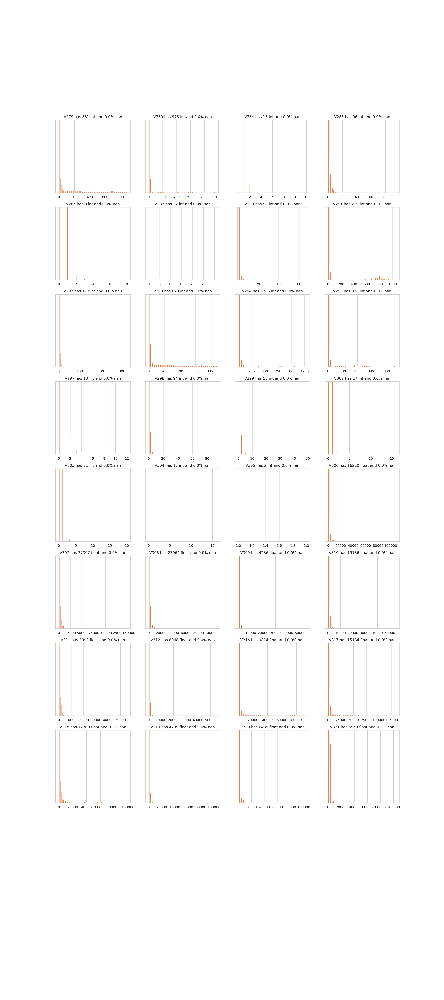

In [ ]:
# 히스토그램(분포도확인)을 여러개 만들기 위한 함수 정의
def make_plots(Vs):
    # 크기 지정을 위한 col 변수
    col = 4
    # Vs 요소의 개수만큼에서 4로 나누어 준 후 1을 더한 값으로 row에 저장됨 (Vs의 요소 개수 = 32 -> 즉, 9)
    row = len(Vs)//4+1
    plt.figure(figsize=(20,row*5))

    # train_df에 있는 V279 열에서 결측값이 아닌 요소의 인덱스 값만 idx에 담아줌(위에서 Vs 정의할때 0번째 원소가 279임)  ->  결측치가 없는 데이터만 선택, 일관성 있는 데이터 선택
    idx = train_df[~train_df[Vs[0]].isna()].index

    for i,v in enumerate(Vs):
        plt.subplot(row,col,i+1)
        n = train_df[v].nunique()
        x = np.sum(train_df.loc[idx,v]!=train_df.loc[idx,v].astype(int))
        y = np.round(100*np.sum(train_df[v].isna())/len(train_df),2)
        t = 'int'
        if x!=0: t = 'float'

        # Vs의열 has 고유값개수 int(float) and null값의 비율% nan
        plt.title(v+' has '+str(n)+' '+t+' and '+str(y)+'% nan')
        # y축을 지정해주지 않으면 자동으로 matplotlib에서 y축을 출력하기 때문에 가시성을 위해 비워주는 작업
        plt.yticks([])
        # 출력할 히스토그램의 속성을 지정할 h 변수에 막대의 개수를 100개로 지정한 후 train_df에서 V에 해당하는 열들을 출력하게 됩니다.
        h = plt.hist(train_df.loc[idx,v],bins=100) # bin은 X축의 영역을 말하는 것입니다.
        # 히스토그램의 특징 h[0]: bin에 들어가는 요소들의 값들, h[1]: 히스토그램의 각 구간 경계값을 수치로 표현한 것, h[2]: 히스토그램의 모든 막대를 포함하는 리스트
        # 즉, 요소 값이 있다면 요소의 값 중 2번째로 크기가 큰 것을 y축의 높이로 지정한다라는 뜻입니다.
        if len(h[0])>1: plt.ylim((0,np.sort(h[0])[-2]))
        h = plt.hist(train_df.loc[idx,v],bins=100)
        if len(h[0])>1: plt.ylim((0,np.sort(h[0])[-2]))
    plt.show()
make_plots(Vs)

#### 히스토그램 분석
예를 들어, V279 변수는 0에서 350 사이의 값에 많이 몰려 있습니다. 이는 대부분의 거래가 이 범위 내에서 이루어짐을 나타냅니다. 반면, V285 변수는 0에서 20 사이에 값들이 몰려 있음을 보여줍니다. 이런 분포를 통해 각 변수의 값이 정상적으로 분포하는지, 아니면 특정 패턴을 보이는지 확인할 수 있습니다.

### 히트맵

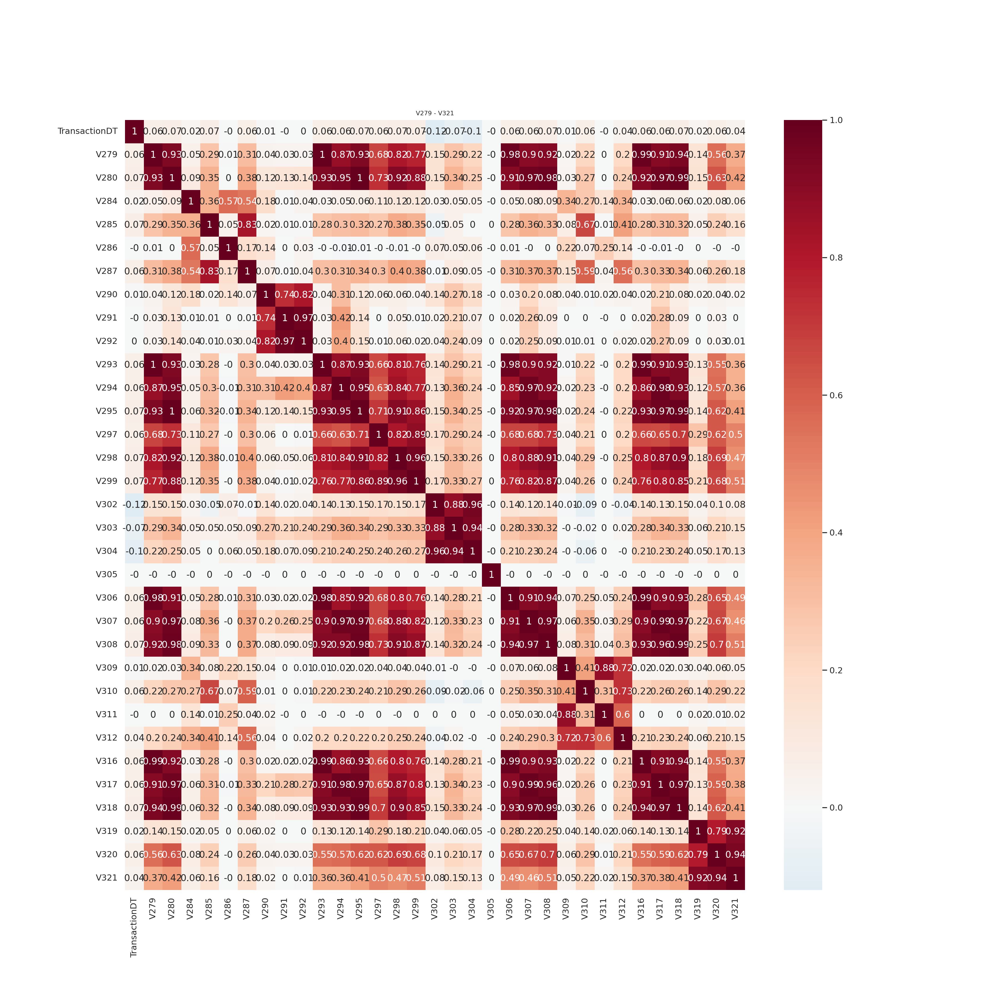

In [ ]:
def make_corr(Vs,Vtitle=''):
    # 'TransactionDT'와 Vs의 변수들로 열 목록 생성
    cols = ['TransactionDT'] + Vs
    plt.figure(figsize=(18,18))
    sns.heatmap(np.around(train_df[cols].corr(),2), cmap='RdBu_r', annot=True, center=0.0)
    if Vtitle!='': plt.title(Vtitle,fontsize=8)
    else: plt.title(Vs[0]+' - '+Vs[-1],fontsize=8)
    plt.show()

make_corr(Vs,Vtitle)

In [ ]:
# 히트맵 기준으로 상관관계가 있는 것들을 []로 묶어서 graps 에 담아줌
grps = [[279,280,293,294,295,298,299],[284],[285,287],[286],[290,291,292],[297], [302,303,304],[305],[306,307,308,316,317,318],[309,311],[310,312],[319,320,321]]
def reduce_group(grps,c='V'):
    use = [] # 사용할 변수들을 저장할 리스트
    for g in grps:
        # 최대 고유 값 개수,  최대 고유 값을 가지는 변수의 초기값
        mx = 0; vx = g[0]
        for gg in g:
            # 변수의 고유 값 개수를 계산
            n = train_df[c+str(gg)].nunique()
            # 고유 값 개수가 최대값보다 크면 업데이트
            if n>mx:
                mx = n
                vx = gg
            #print(str(gg)+'-'+str(n),', ',end='')
        use.append(vx)
        #print()
    print('Use these',use)
reduce_group(grps)

- [294, 284, 285, 286, 291, 297, 303, 305, 307, 309, 310, 320]
- 선택된 변수들중에 고유 값이 가장 큰 변수들

### V1-V11, D11 의 히스토그램, 히트맵

In [ ]:
Vc = ['dayr','isFraud','TransactionAmt','card1','addr1','D1n','D11n'] # 결측치가 279287개 인 피처들
Vs = nans_groups[279287]  # 결측치가 279287개 인 그룹들
Vtitle = 'V1 - V11, D11'

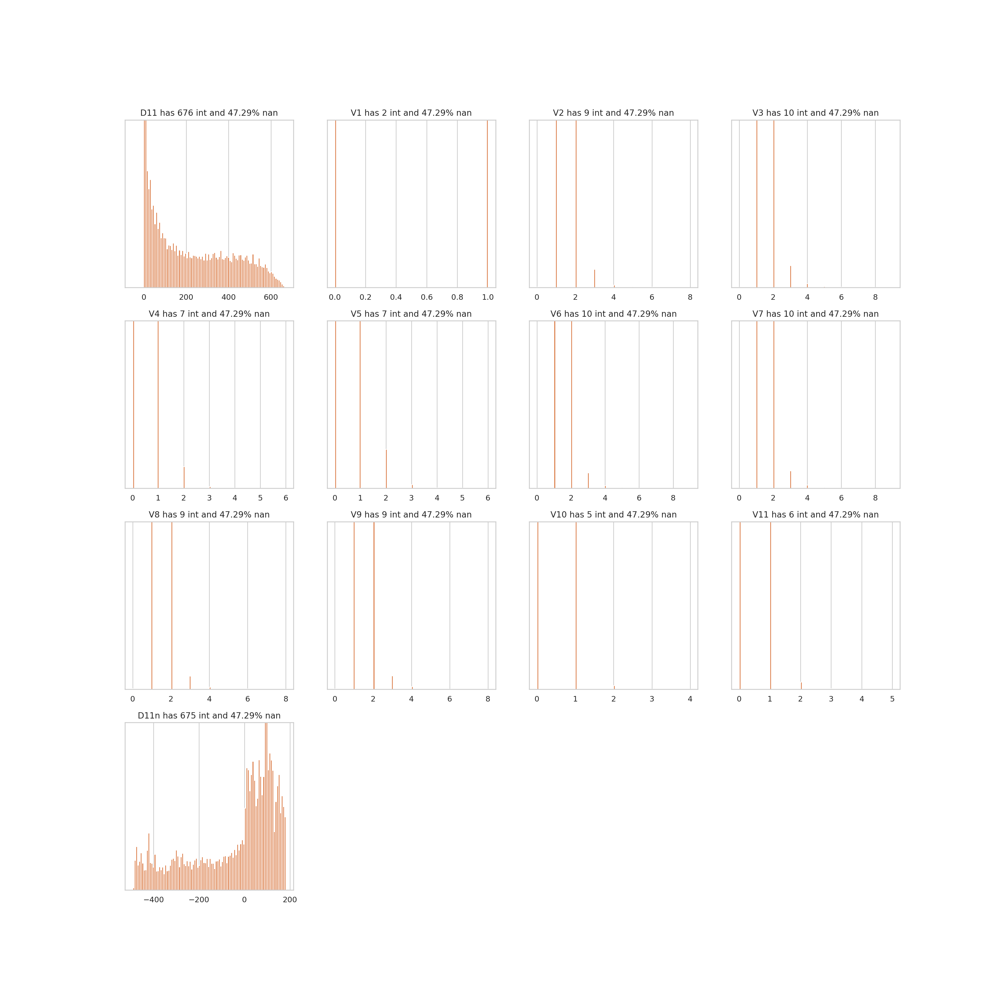

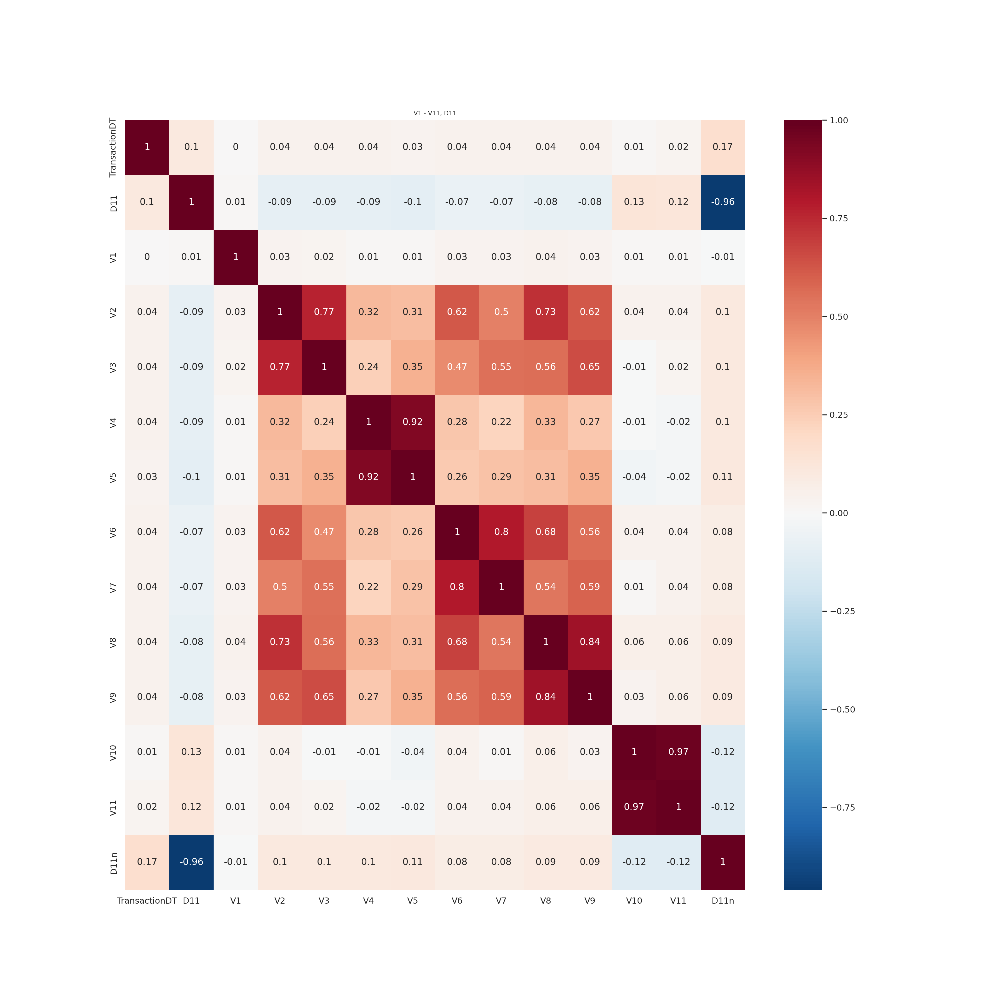

In [ ]:
make_plots(Vs)
make_corr(Vs,Vtitle)

In [ ]:
# 상관관계있는 변수들끼리 그룹해줌
grps = [[1],[2,3],[4,5],[6,7],[8,9],[10,11]]
reduce_group(grps)

- 그룹을 해준것들 중에 고유값이 많은 피쳐들
- [1, 3, 4, 6, 8, 11]
- 이 피처들이 다른 피처들 보다 더 많은 정보를 포함하고 있을 가능성?

< 그래프 분석 >
1. 대부분 V 피처들은 값들이 특정 값들에 몰려있음
2. 결측치 비율은 47.29% 동일
3. D11과 D11n의 값이 넓은 범위에 분포
4. D11과 D11n의 분포 차이를 통해, 변형된 피처가 원래 피처와 어떻게 다른지 이해하고, 이를 모델링에 활용
---

### V12-V34

In [ ]:
Vs = nans_groups[76073]
make_plots(Vs)
make_corr(Vs)

In [ ]:
grps = [[12,13],[14],[15,16,17,18,21,22,31,32,33,34],[19,20],[23,24],[25,26],[27,28],[29,30]]
reduce_group(grps)

Use these [13, 14, 17, 20, 23, 26, 27, 30]


- 결측치가 76073개인 그룹에서 고유 값이 많은 피처들
-  V [13, 14, 17, 20, 23, 26, 27, 30]

### V35 - V52

In [ ]:
Vs = nans_groups[168969]
make_plots(Vs)
make_corr(Vs)

In [ ]:
grps = [[35,36],[37,38],[39,40,42,43,50,51,52],[41],[44,45],[46,47],[48,49]]
reduce_group(grps)

- 결측치 값이 168969 개인 그룹들중에 고유값이 많은 피처들
- V [36, 37, 40, 41, 44, 47, 48]

### V53 - V74

In [ ]:
Vs = nans_groups[77096]
make_plots(Vs)
make_corr(Vs)

In [ ]:
grps = [[53,54],[55,56],[57,58,59,60,63,64,71,72,73,74],[61,62],[65],[66,67],[68],[69,70]]
reduce_group(grps)

Use these [54, 56, 59, 62, 65, 67, 68, 70]


- 결측치 값이 77096개 인 그룹들 중에 고육값이 많은 피처들
- V [54, 56, 59, 62, 65, 67, 68, 70]
---

### V75 - V94

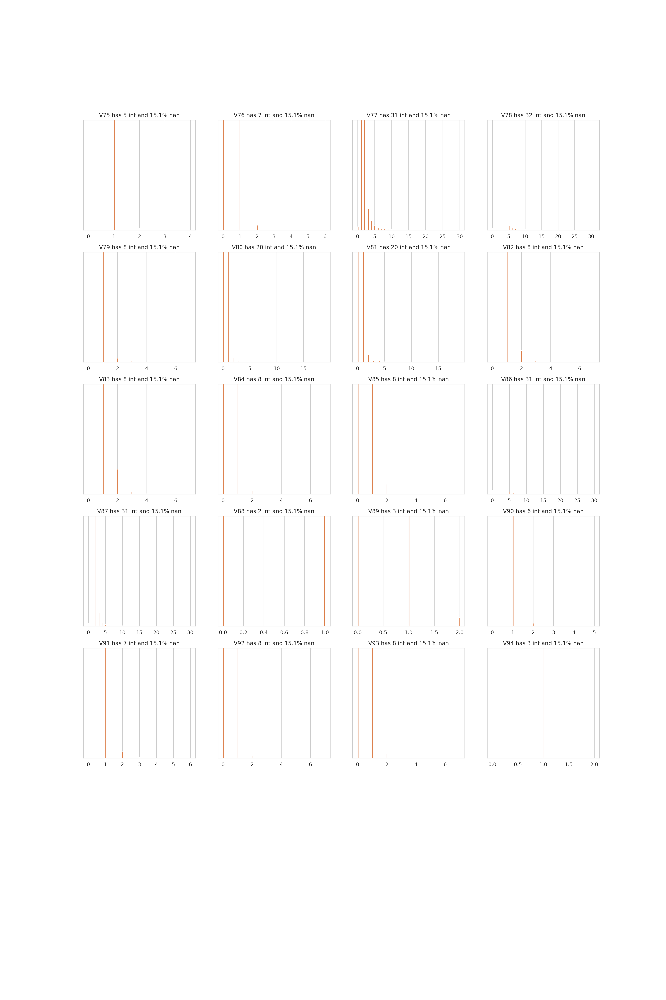

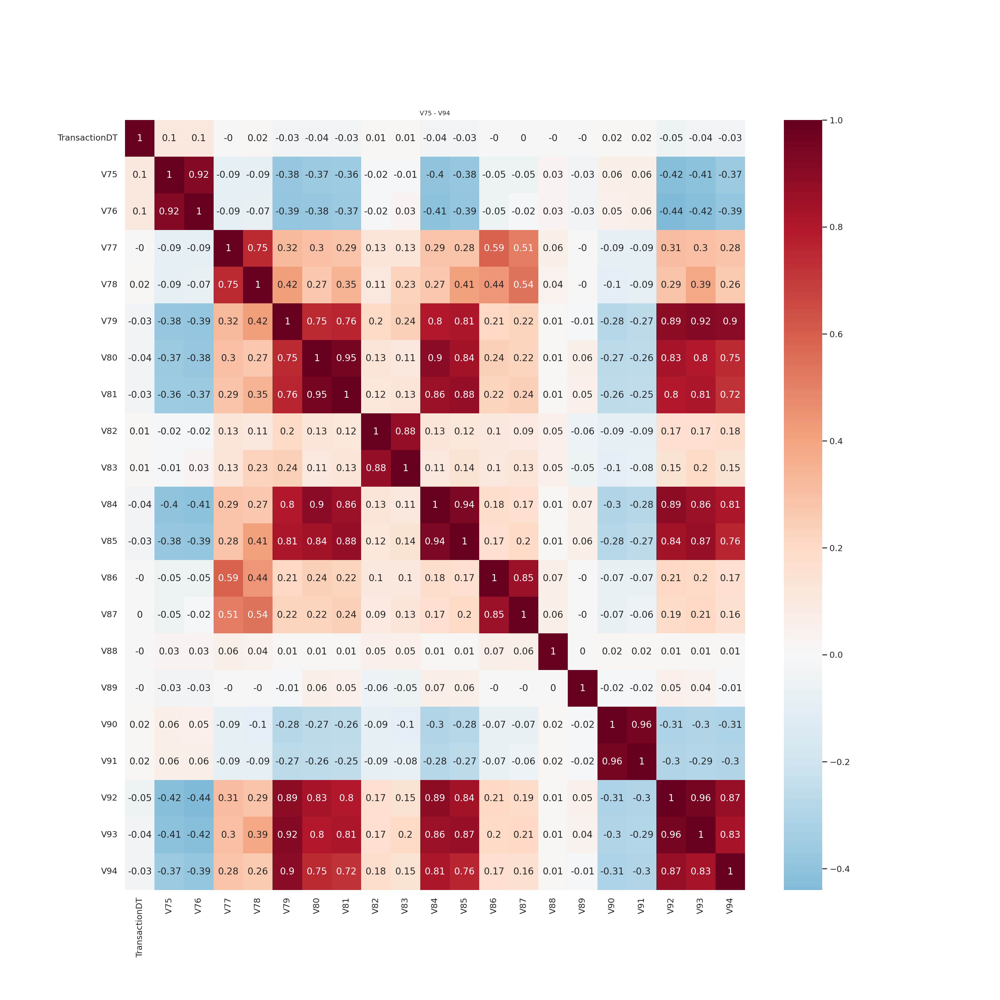

In [ ]:
Vs = nans_groups[89164]
make_plots(Vs)
make_corr(Vs)

In [ ]:
grps = [[75,76],[77,78],[79,80,81,84,85,92,93,94],[82,83],[86,87],[88],[89],[90,91]]
reduce_group(grps)

Use these [76, 78, 80, 82, 86, 88, 89, 91]


- 결측치가 89164 개인 그룹중에 고유값이 많은 피처들
- V [76, 78, 80, 82, 86, 88, 89, 91]
---

### V95 - V137

In [ ]:
Vs = nans_groups[314]
make_corr(Vs)

Output hidden; open in https://colab.research.google.com to view.

- 결측치가 314개 인 그룹들 히트맵
---

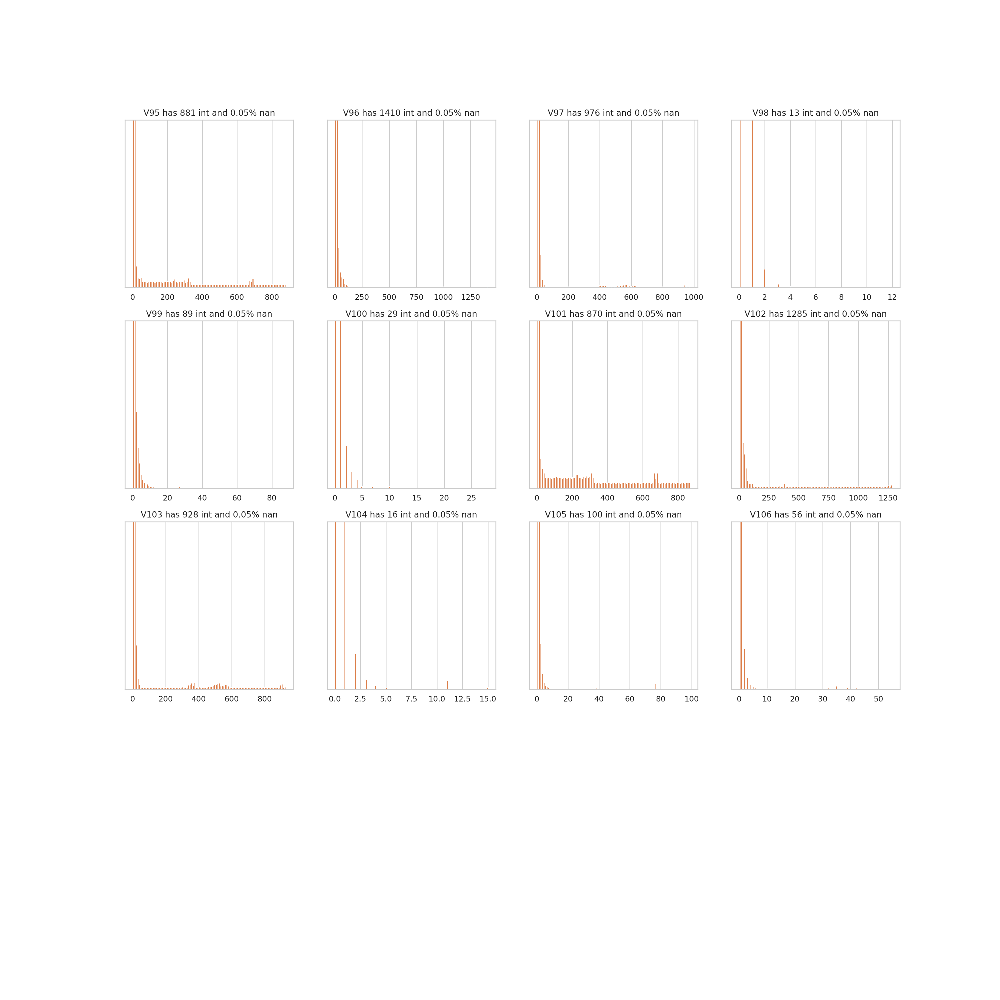

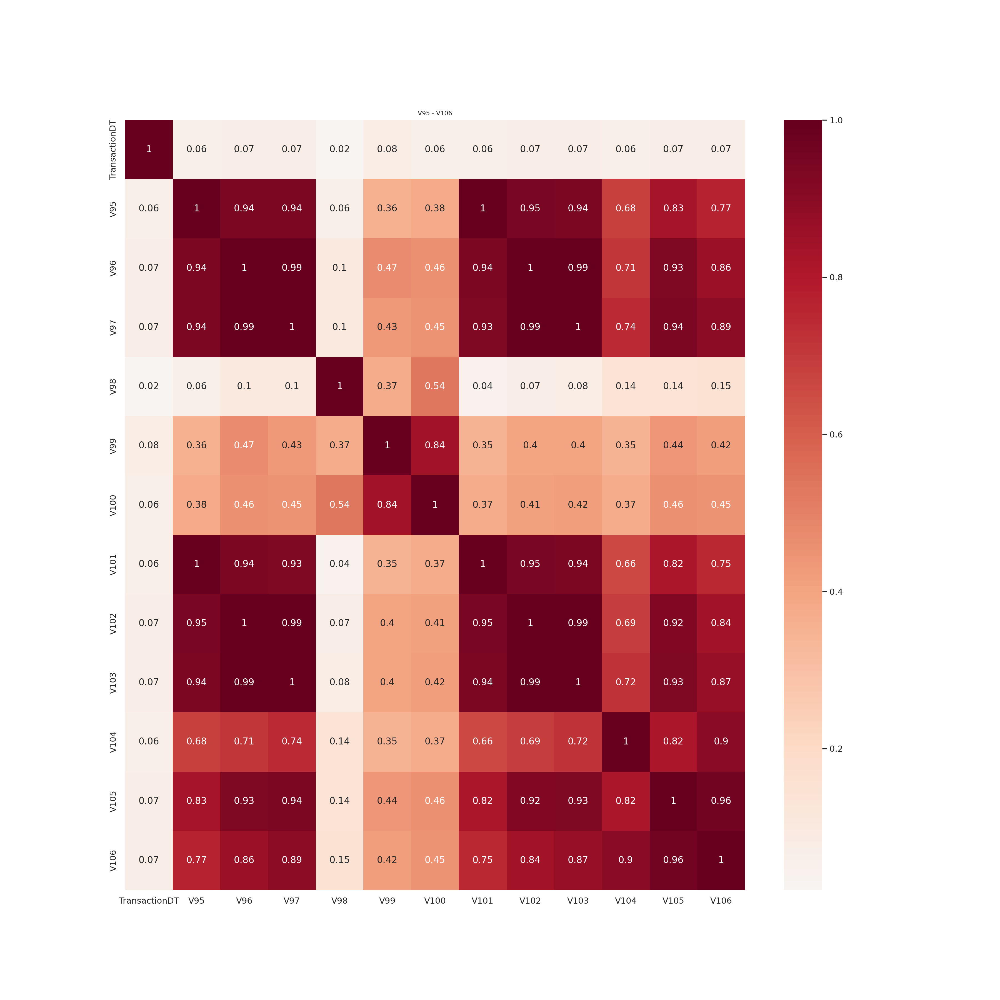

In [ ]:
# V95 - V107 까지 히스토그램, 히트맵
Vs = ['V'+str(x) for x in range(95,107)]
make_plots(Vs)
make_corr(Vs)

In [ ]:
grps = [[95,96,97,101,102,103,105,106],[98],[99,100],[104]]
reduce_group(grps)

Use these [96, 98, 99, 104]


- 결측치가 314개인 그룹, V95 - V106 에서 고유값이 많은 피처들
- V [96, 98, 99, 104]
---

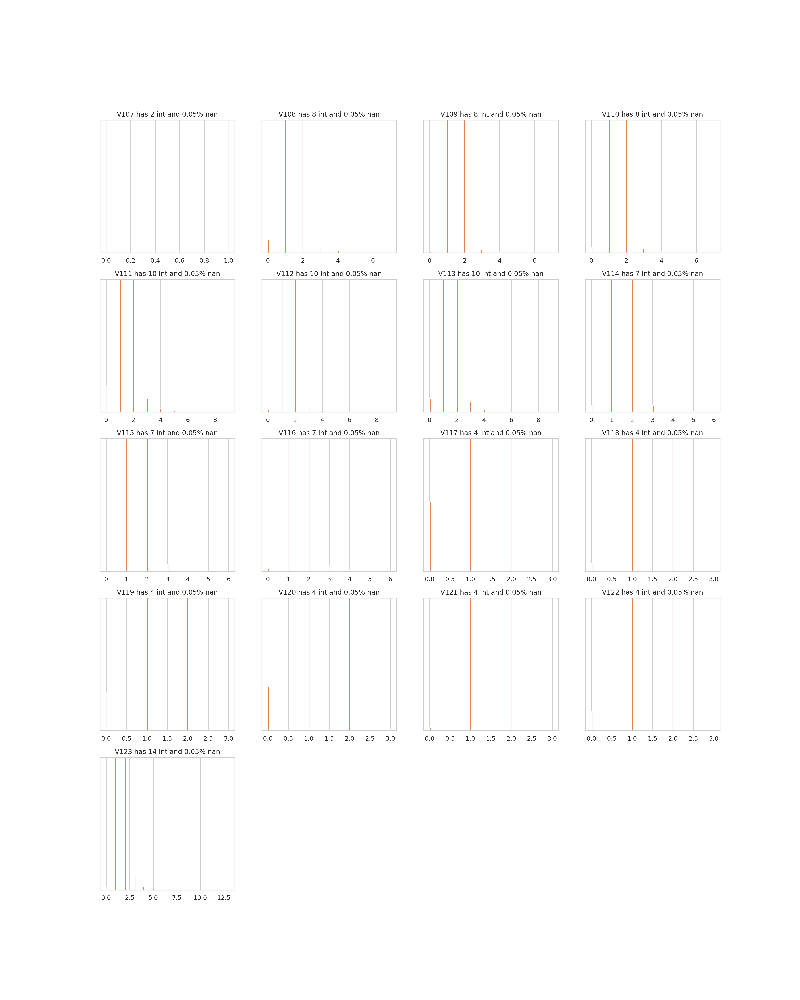

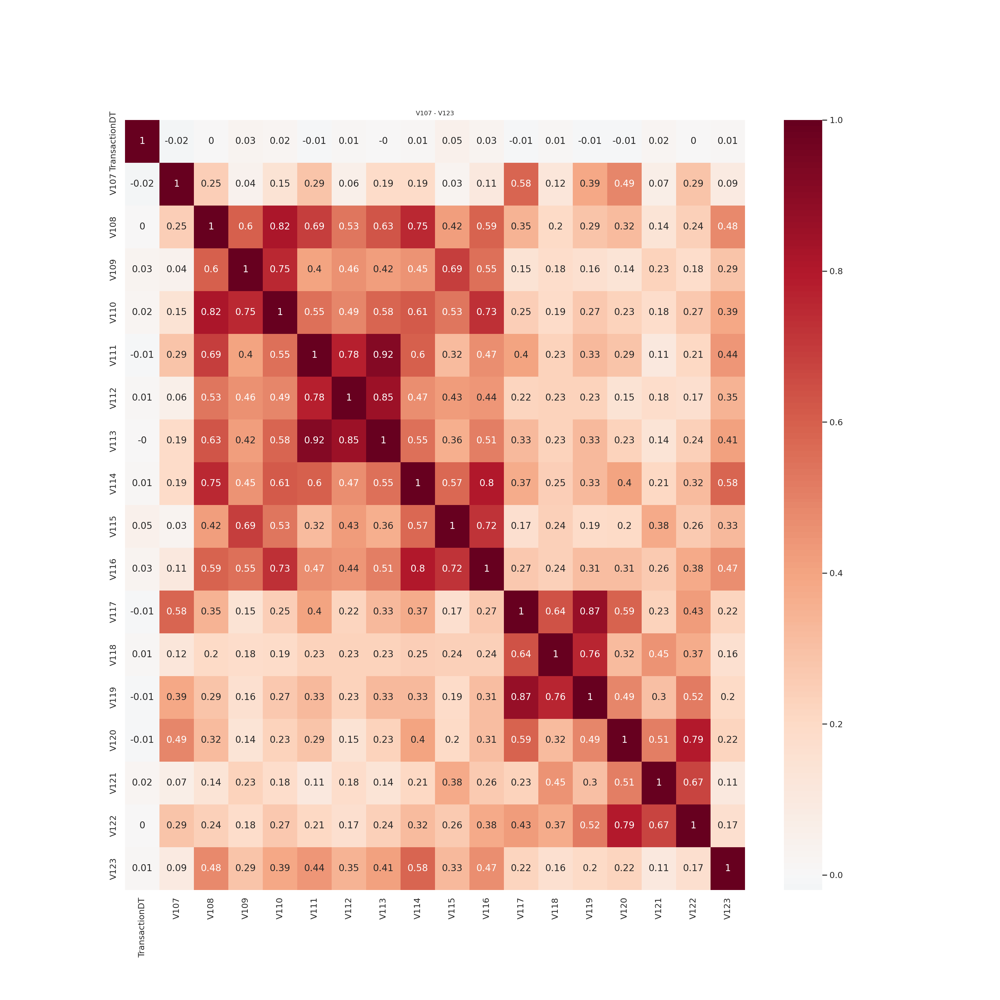

In [ ]:
Vs = ['V'+str(x) for x in range(107,124)]
make_plots(Vs)
make_corr(Vs)

In [ ]:
grps = [[107],[108,109,110,114],[111,112,113],[115,116],[117,118,119],[120,122],[121],[123]]
reduce_group(grps)

Use these [107, 108, 111, 115, 117, 120, 121, 123]


- 결측치가 314개인 그룹, V107 - V123 에서 고유값이 많은 피처들
- V [107, 108, 111, 115, 117, 120, 121, 123]
---

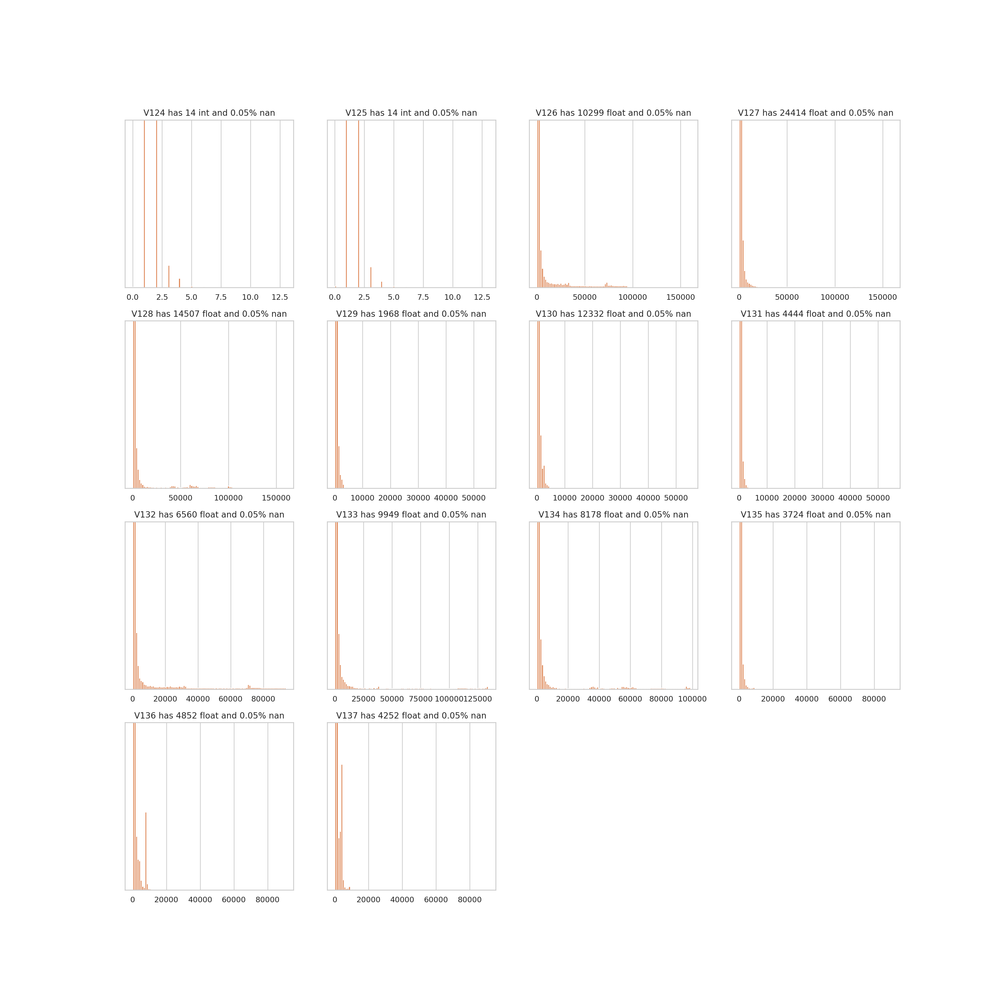

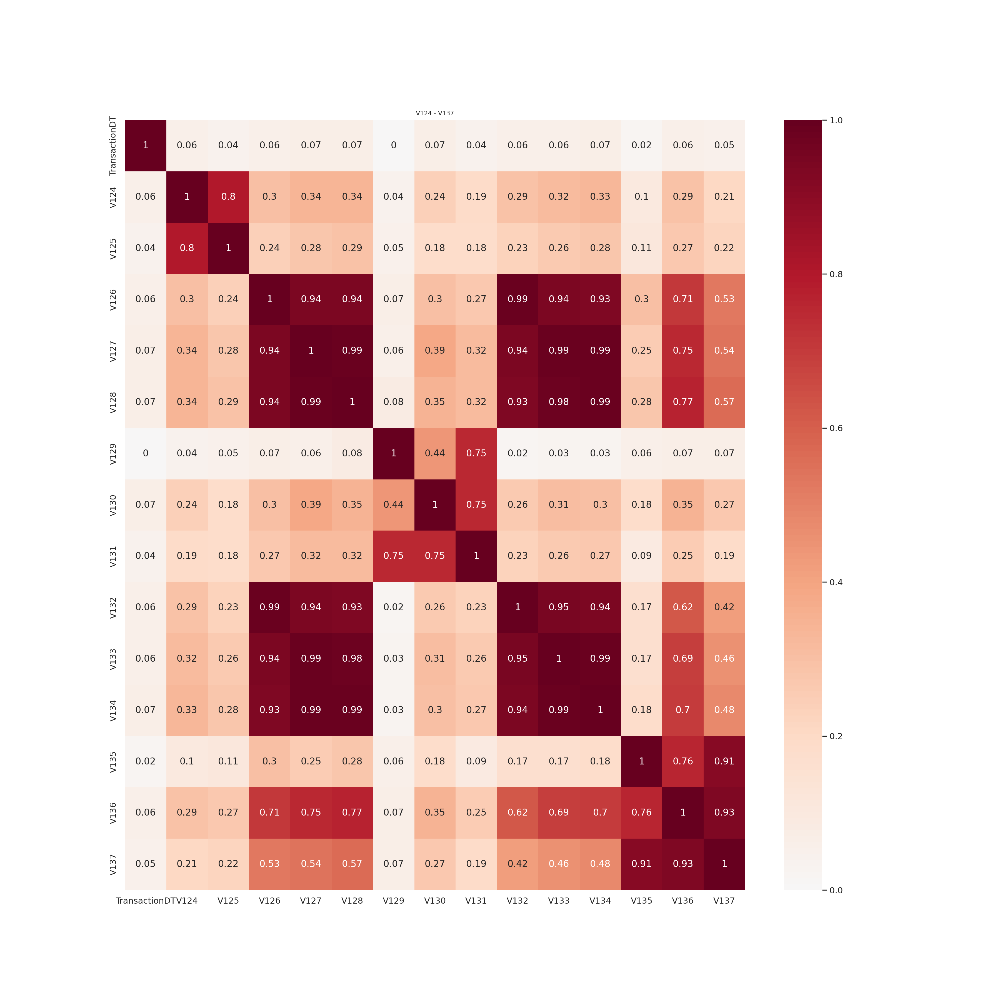

In [ ]:
Vs = ['V'+str(x) for x in range(124,138)]
make_plots(Vs)
make_corr(Vs)

In [ ]:
grps = [[124,125],[126,127,128,132,133,134],[129],[130,131],[135,136,137]]
reduce_group(grps)

Use these [124, 127, 129, 130, 136]


- 결측치가 314개인 그룹, V124 - V137 에서 고유값이 많은 피처들
- V [124, 127, 129, 130, 136]
---

### V138 ~ V163

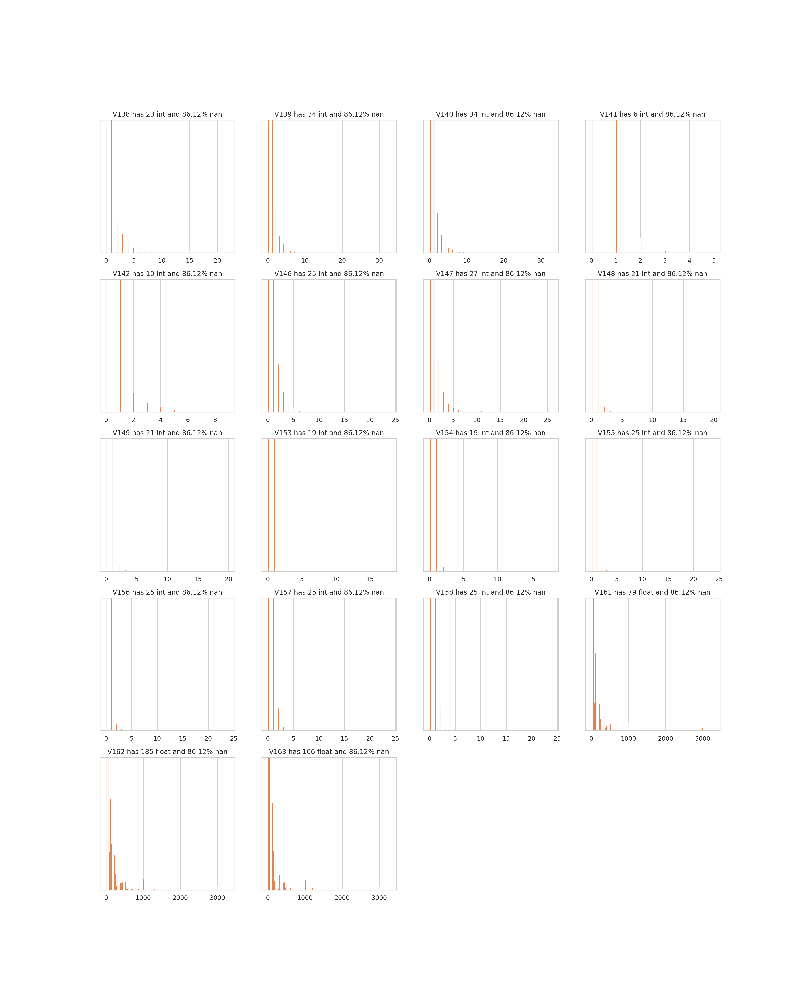

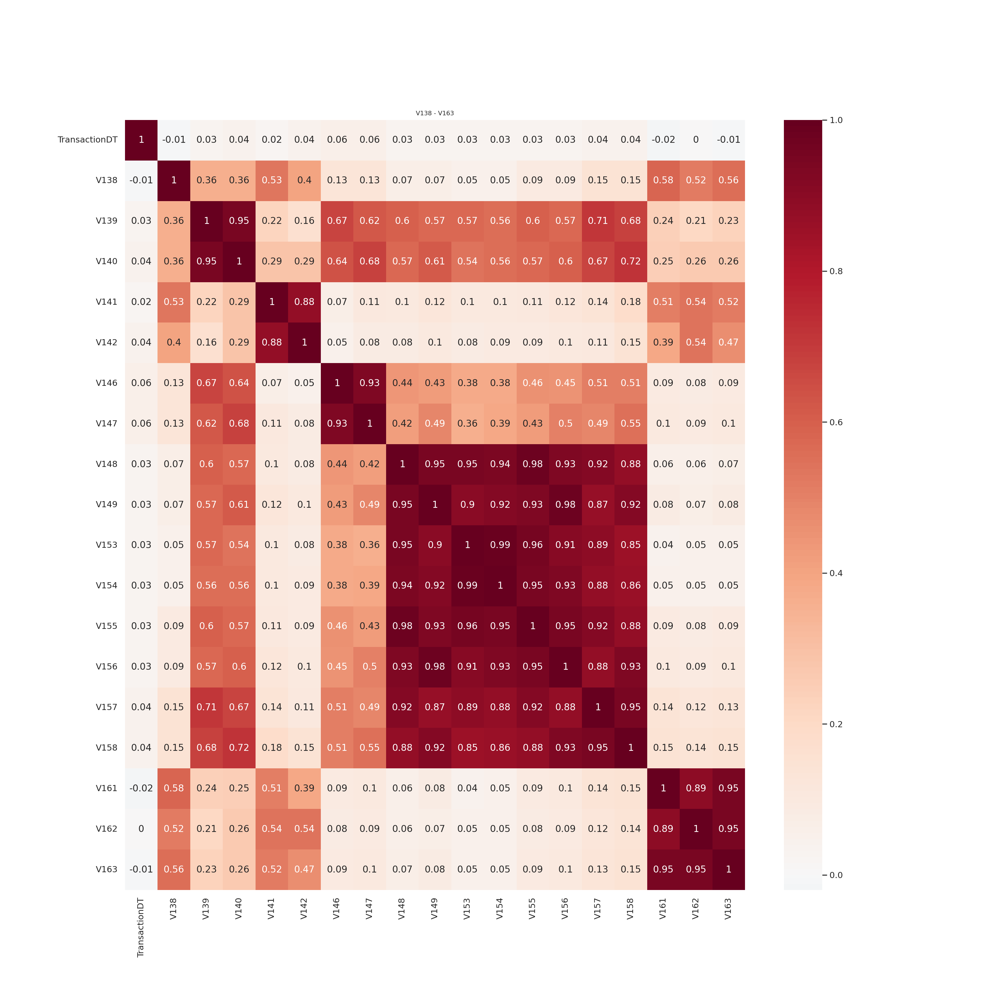

In [ ]:
Vs = nans_groups[508595]
make_plots(Vs)
make_corr(Vs)

In [ ]:
grps = [[138],[139,140],[141,142],[146,147],[148,149,153,154,156,157,158],[161,162,163]]
reduce_group(grps)

Use these [138, 139, 142, 147, 156, 162]


- 결측치가 508595개 인 그룹중에서 고유값이 많은 피처들
- V [138, 139, 142, 147, 156, 162]
---

### V143 ~ V166

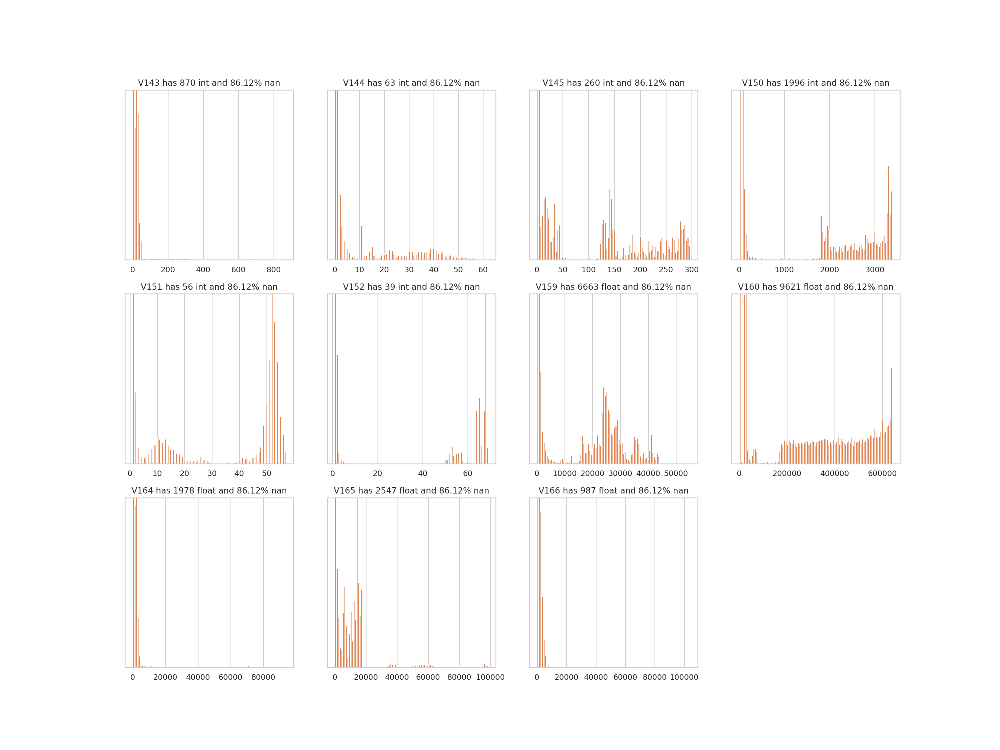

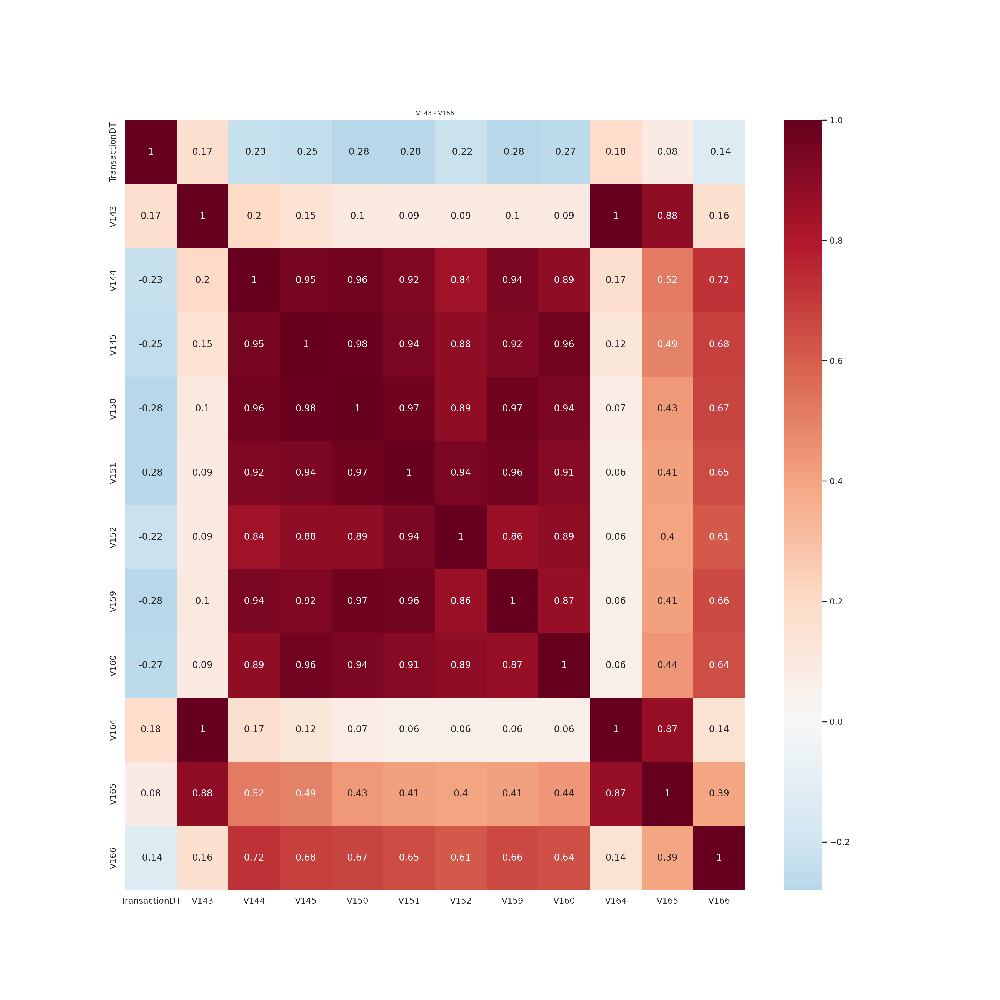

In [ ]:
Vs = nans_groups[508589]
make_plots(Vs)
make_corr(Vs)

In [ ]:
grps = [[143,164,165],[144,145,150,151,152,159,160],[166]]
reduce_group(grps)

Use these [165, 160, 166]


- 결측치 값이 508589개 인 그룹중에서 고유값이 많은 피처들
- V [165, 160, 166]
---

### V167 ~ V216

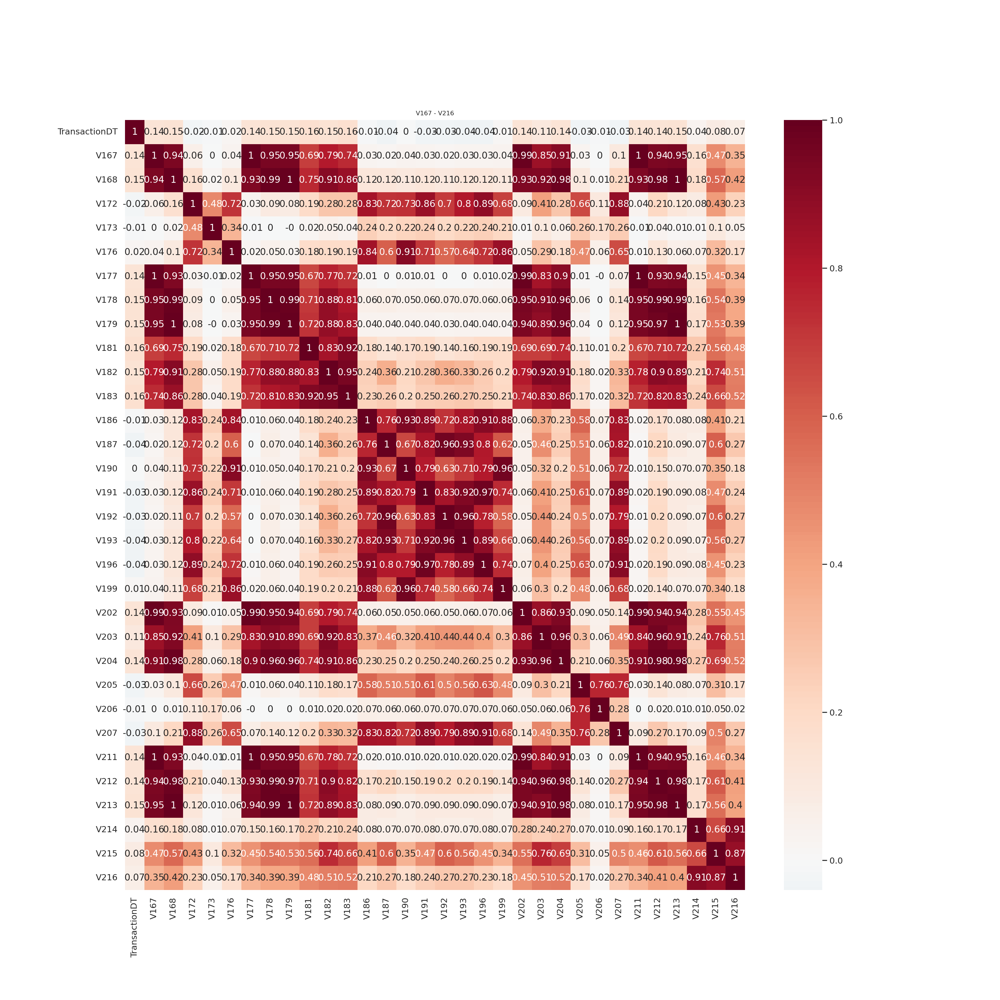

In [ ]:
Vs = [x for x in nans_groups[450909]]
make_corr(Vs)

- 결측치 값이 450909개 인 피처들 히트맵
---

### V 186 이전까지 결측치가 450909개 인 피처들

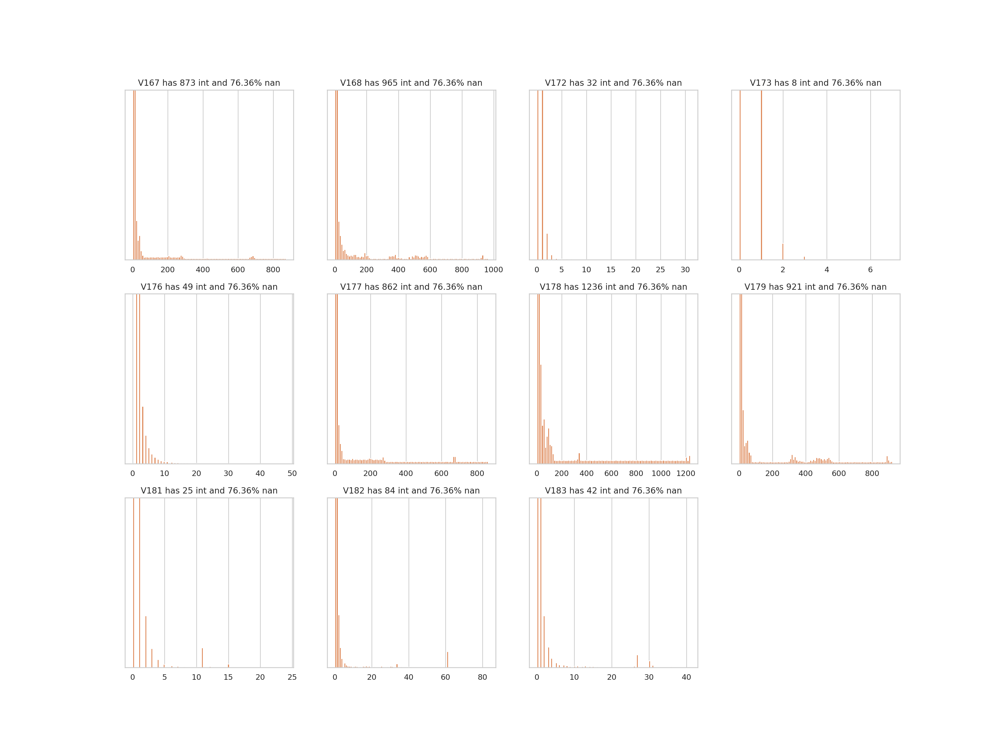

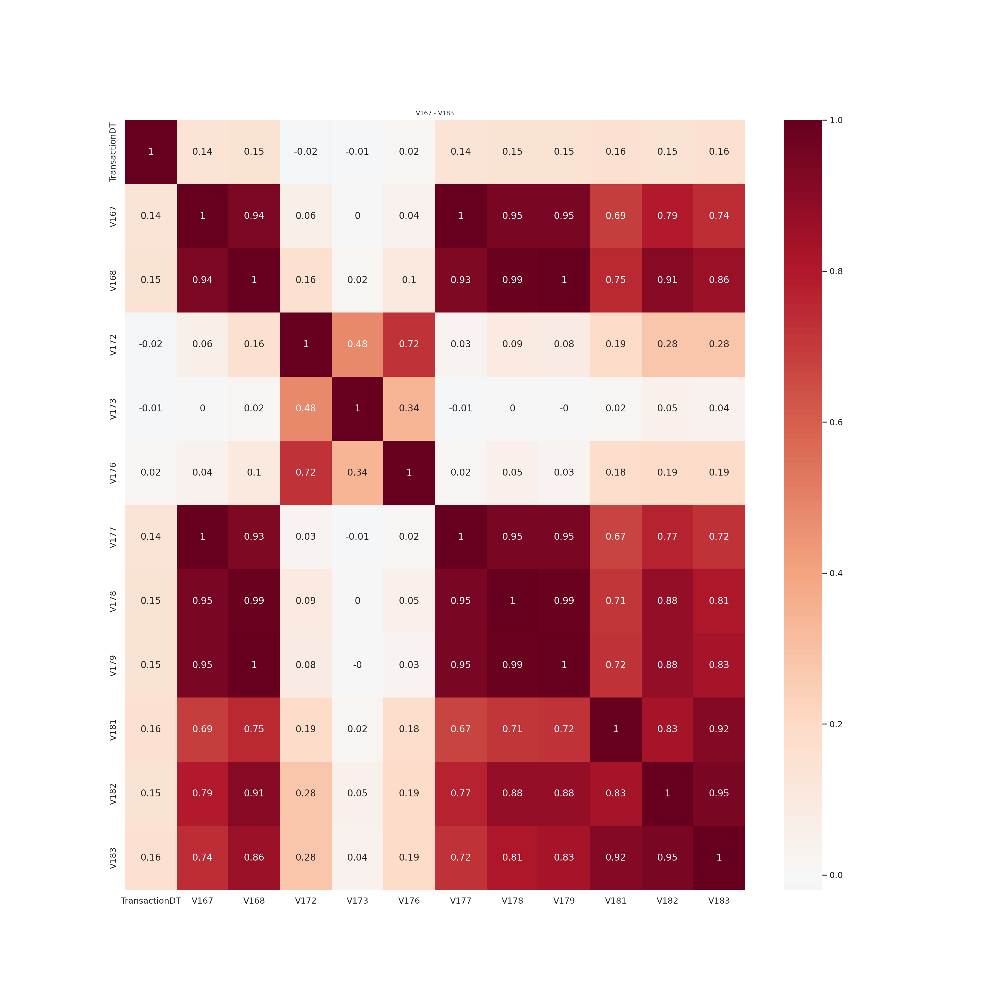

In [ ]:
Vs = [x for x in nans_groups[450909] if int(x[1:])<186]
make_plots(Vs)
make_corr(Vs)

In [ ]:
grps = [[167,168,177,178,179],[172,176],[173],[181,182,183]]
reduce_group(grps)

Use these [178, 176, 173, 182]


- 결측치가 450909개인 피처들 중 V186 이전까지의 피처들 (V167 ~ V183) 중에 고유값이 많은 피처들
- V [178, 176, 173, 182]
---

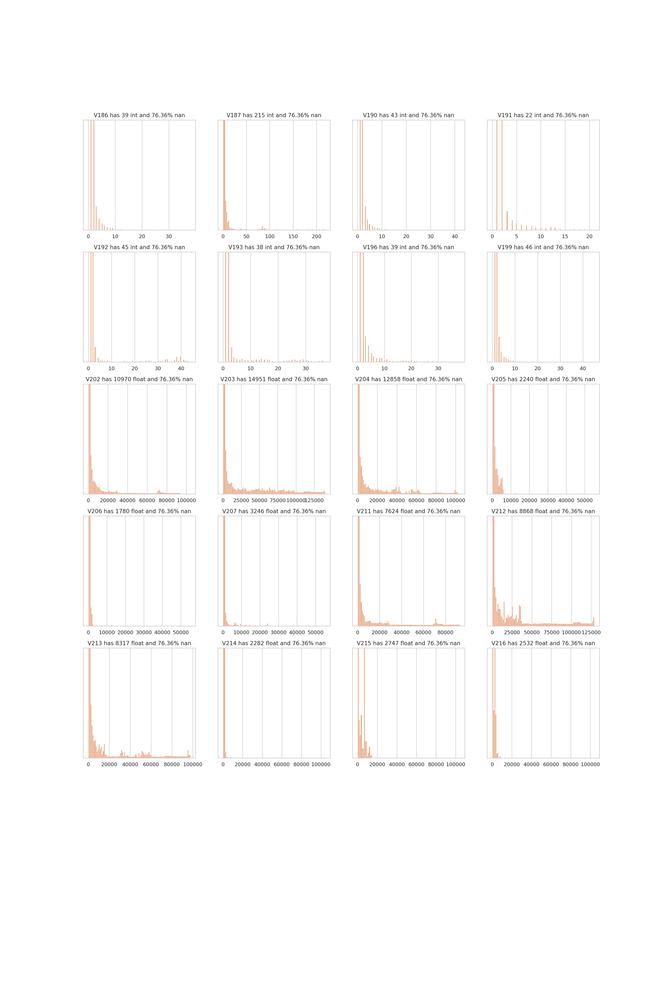

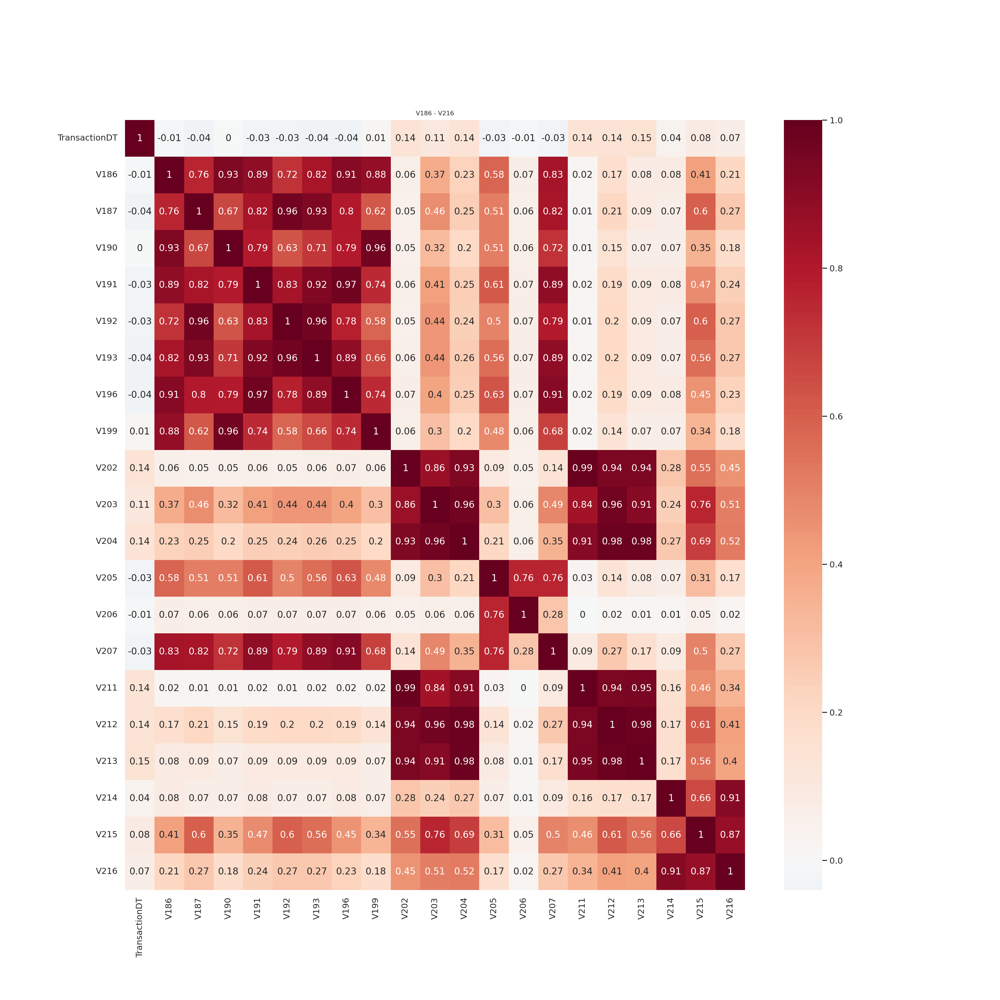

In [ ]:
Vs = [x for x in nans_groups[450909] if (int(x[1:])>183)]
make_plots(Vs)
make_corr(Vs)

In [ ]:
grps = [[186,187,190,191,192,193,196,199],[202,203,204,211,212,213],[205,206],[207],[214,215,216]]
reduce_group(grps)

Use these [187, 203, 205, 207, 215]


- 결측치가 450909개인 피처들 중 V183 이후까지의 피처들 (V183 ~ V216) 중에 고유값이 많은 피처들
- V [187, 203, 205, 207, 215]
---

### V169 ~ V210

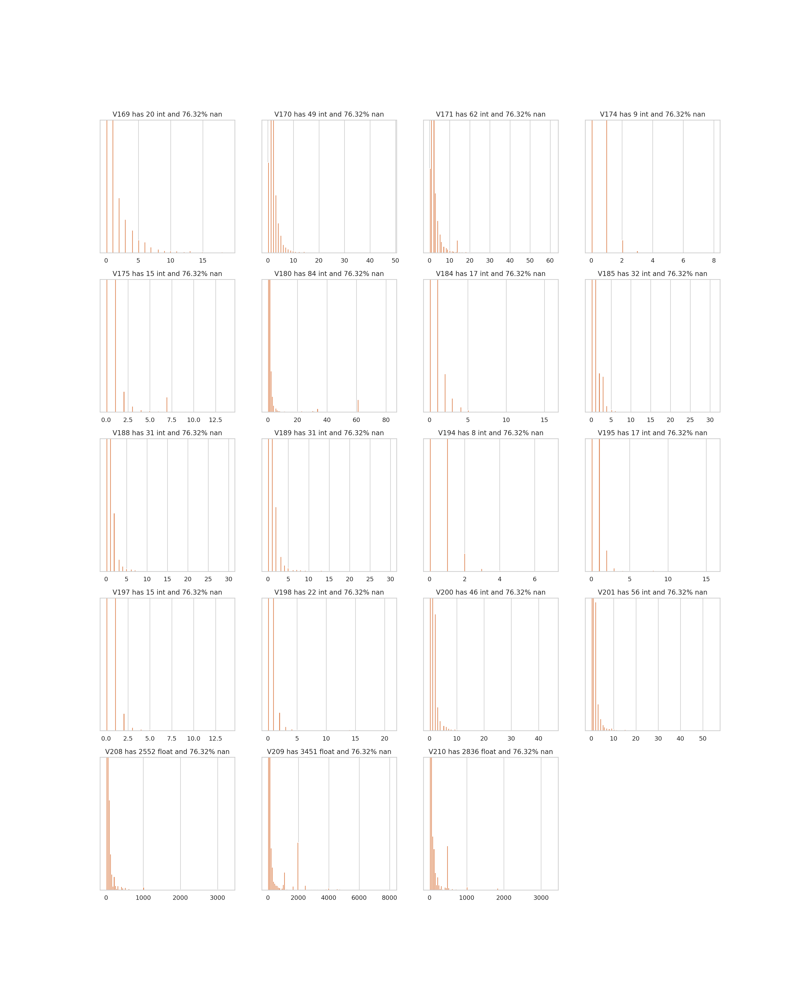

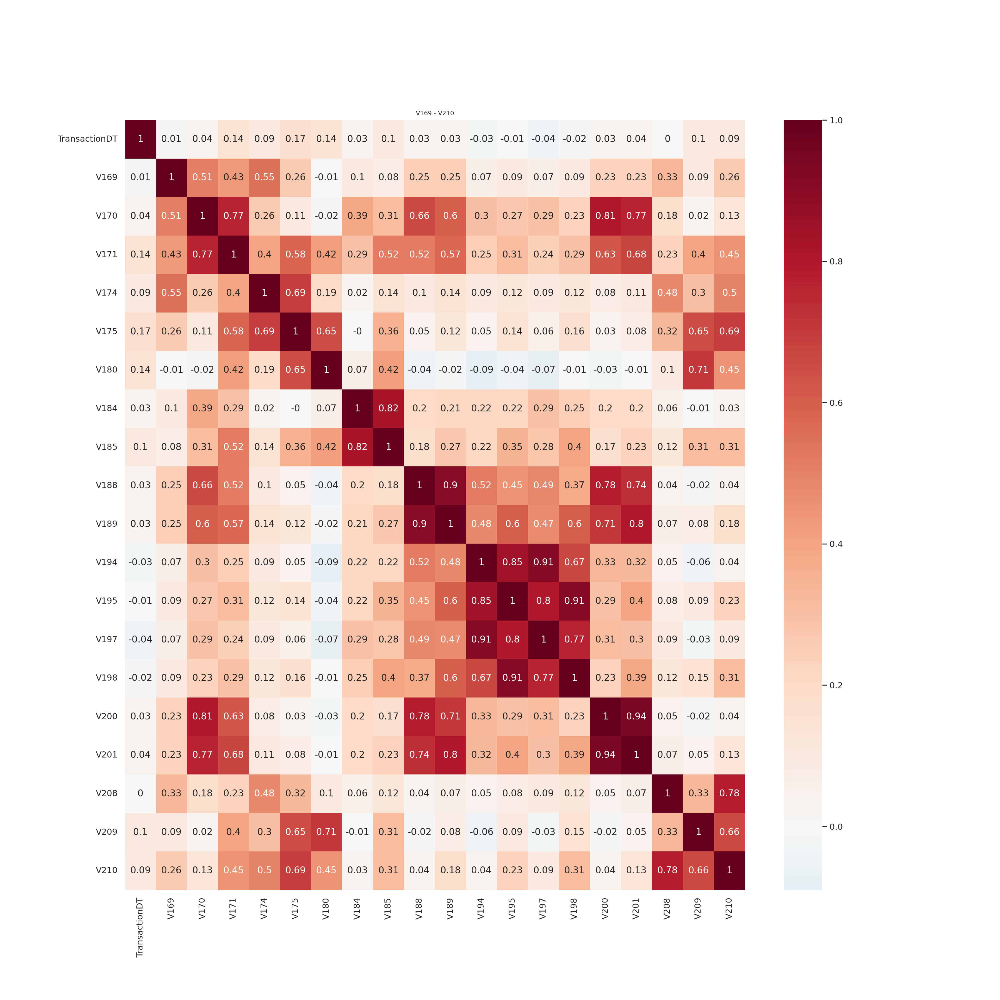

In [ ]:
Vs = nans_groups[450721]
make_plots(Vs)
make_corr(Vs)

In [ ]:
grps = [[169],[170,171,200,201],[174,175],[180],[184,185],[188,189],[194,195,197,198],[208,210],[209]]
reduce_group(grps)

Use these [169, 171, 175, 180, 185, 188, 198, 210, 209]


- 결측치가 450721개인 그룹중에서 고유값이 많은 피처들
- V [169, 171, 175, 180, 185, 188, 198, 210, 209]
---

### V217 ~ V278

In [ ]:
Vs = [x for x in nans_groups[460110]]
make_corr(Vs)

Output hidden; open in https://colab.research.google.com to view.

- 결측치가 460110개 인 그룹 히트맵

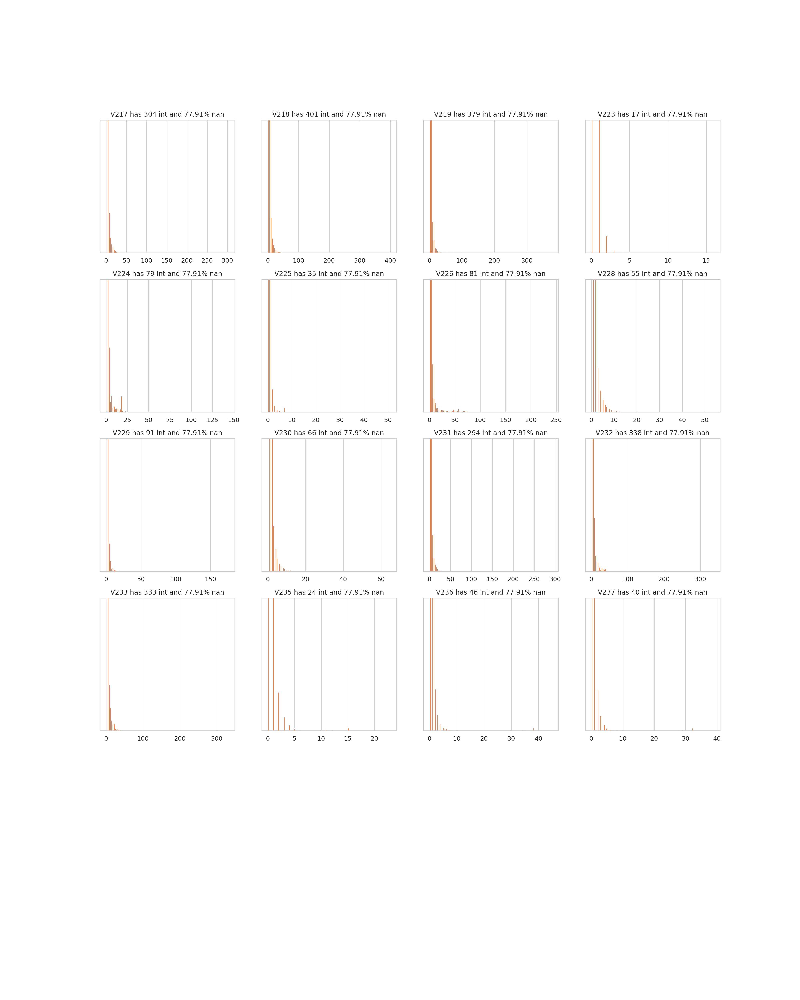

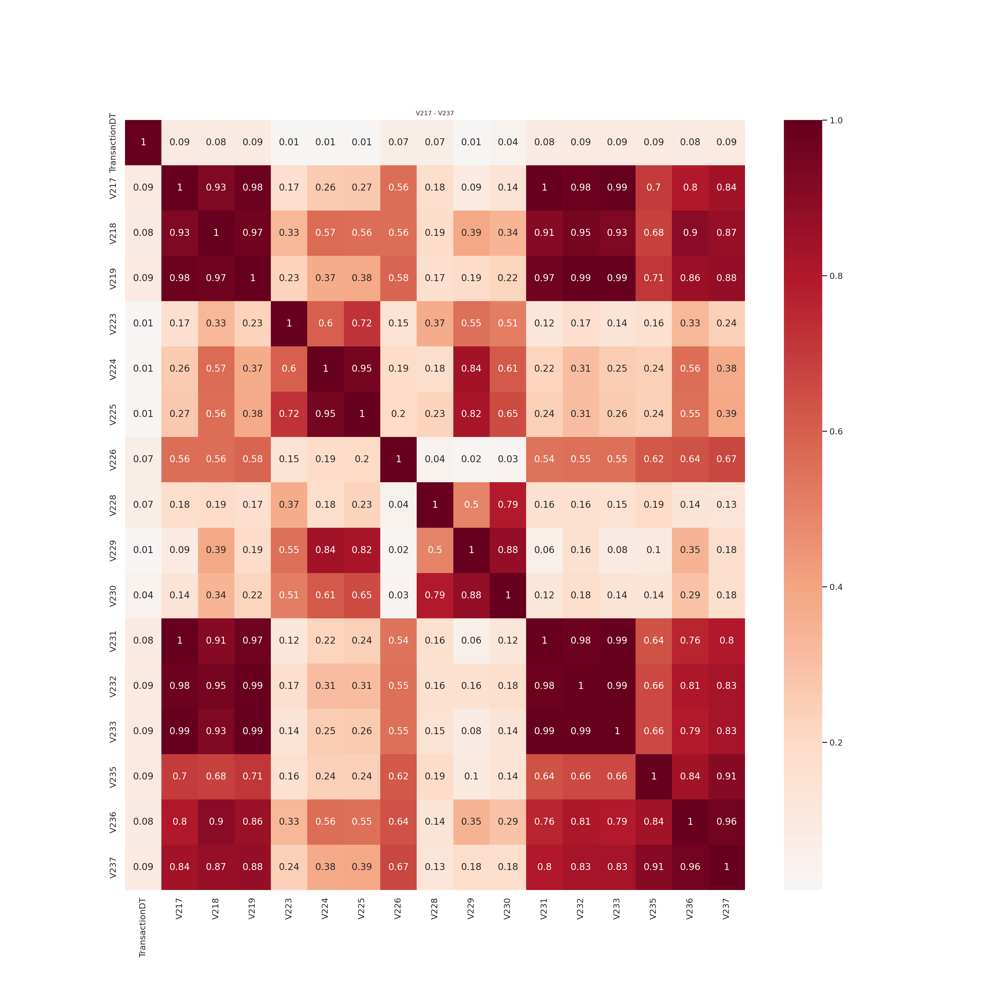

In [ ]:
Vs = [x for x in nans_groups[460110] if int(x[1:])<240]
make_plots(Vs)
make_corr(Vs)

In [ ]:
grps = [[217,218,219,231,232,233,236,237],[223],[224,225],[226],[228],[229,230],[235]]
reduce_group(grps)

Use these [218, 223, 224, 226, 228, 229, 235]


- 결측치 460110개 인 그룹, V217 ~ V237 중에서 고유값이 많은 피처들
- [218, 223, 224, 226, 228, 229, 235]
---

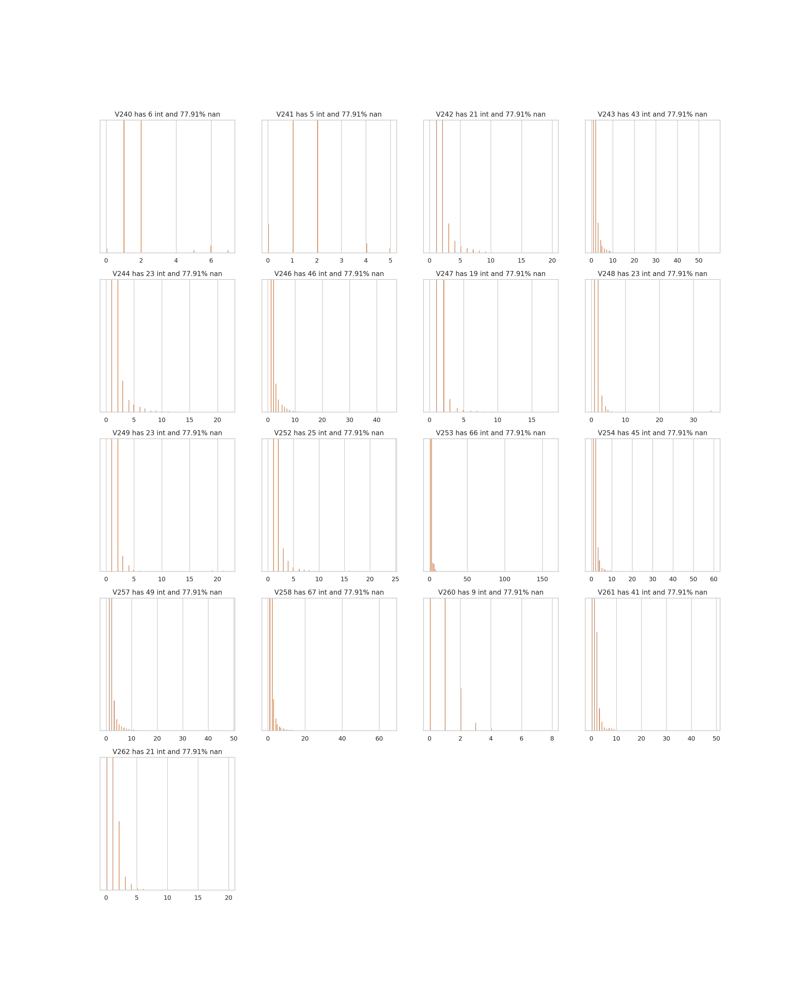

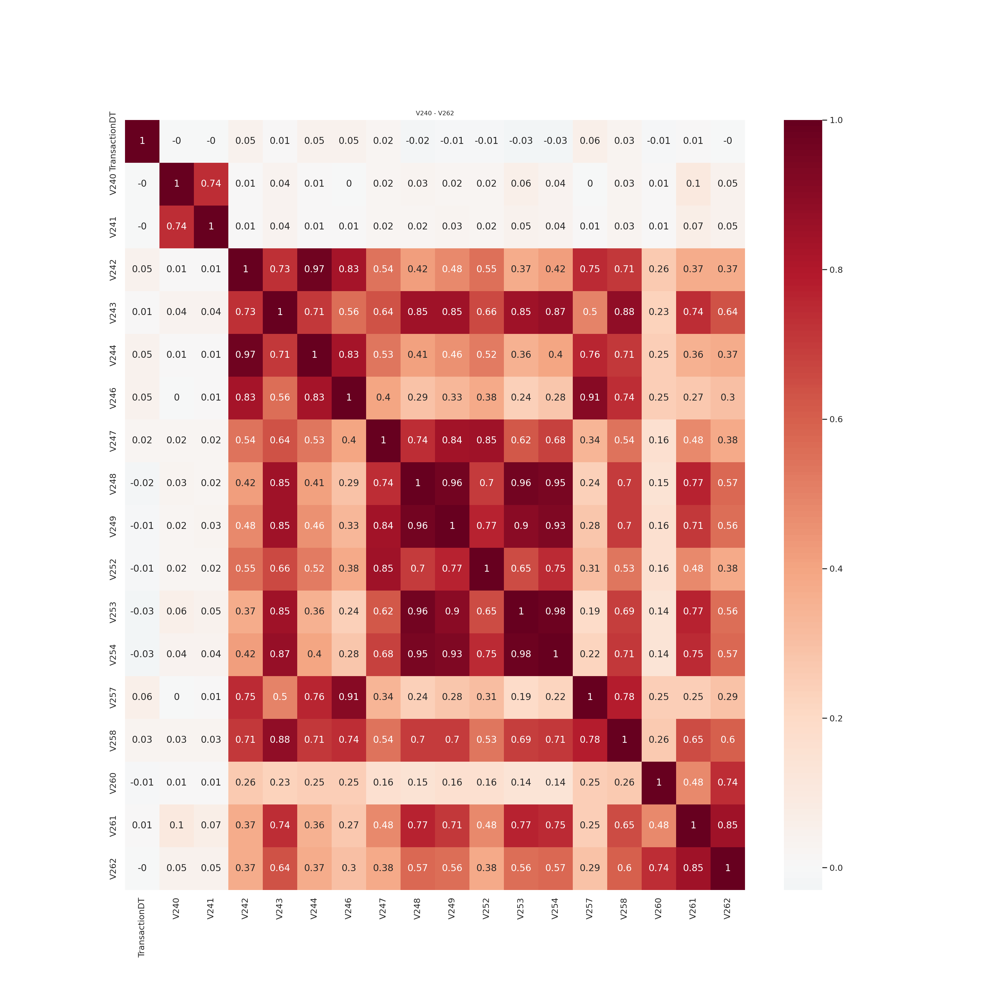

In [ ]:
Vs = [x for x in nans_groups[460110] if (int(x[1:])>237)&(int(x[1:])<263)]
make_plots(Vs)
make_corr(Vs)

In [ ]:
grps = [[240,241],[242,243,244,258],[246,257],[247,248,249,253,254],[252],[260],[261,262]]
reduce_group(grps)

Use these [240, 258, 257, 253, 252, 260, 261]


- 결측치 460110개 인 그룹, V240 ~ V262 중에서 고유값이 많은 피처들
- V [240, 258, 257, 253, 252, 260, 261]
---

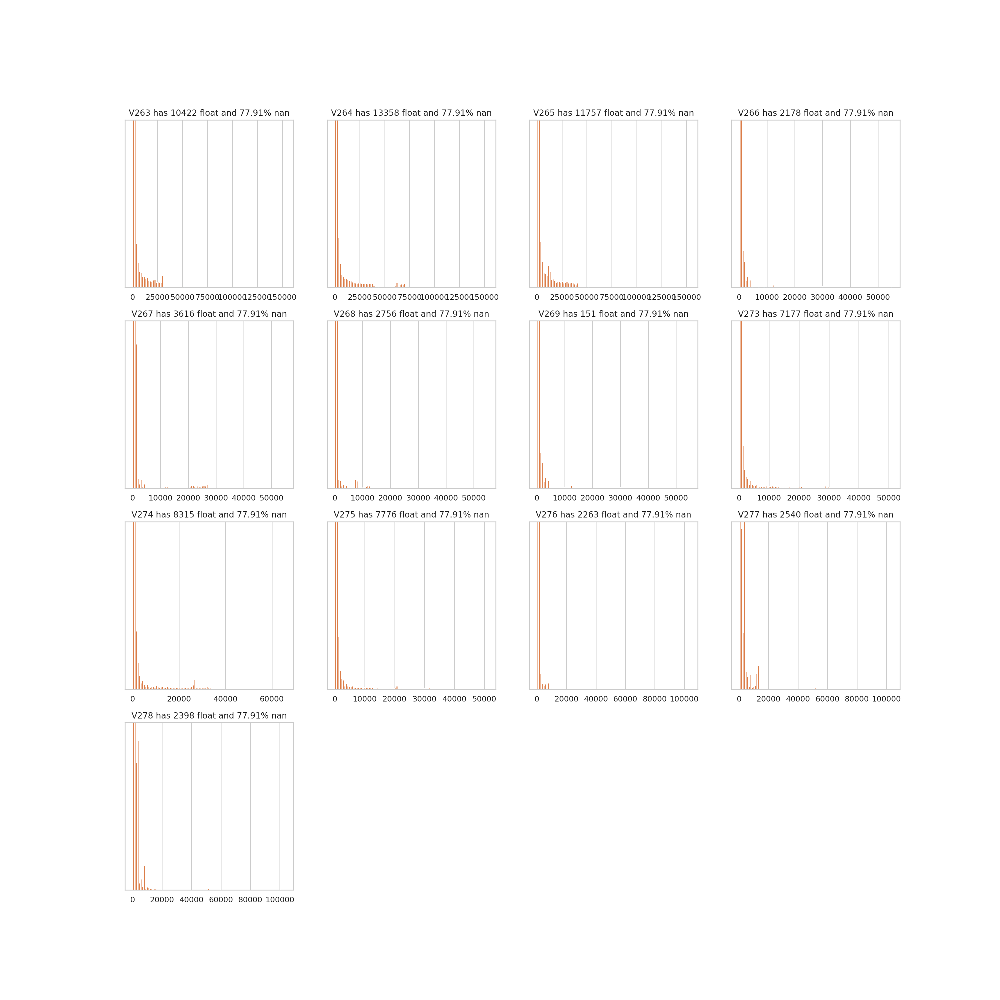

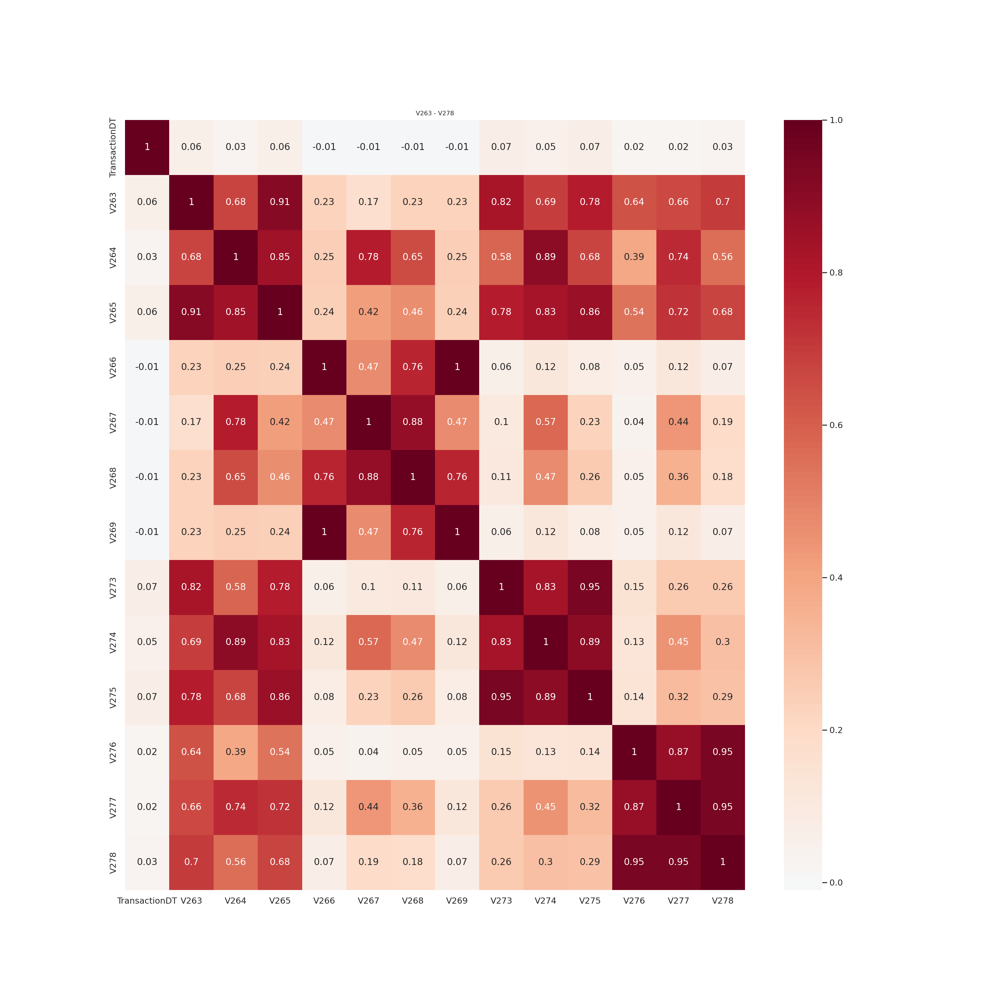

In [ ]:
Vs = [x for x in nans_groups[460110] if (int(x[1:])>262)]
make_plots(Vs)
make_corr(Vs)

In [ ]:
grps = [[263,265,264],[266,269],[267,268],[273,274,275],[276,277,278]]
reduce_group(grps)

Use these [264, 266, 267, 274, 277]


- 결측치 460110개 인 그룹, V263 ~ V278 중에서 고유값이 많은 피처들
- V [264, 266, 267, 274, 277]
---

### V220 ~ V272

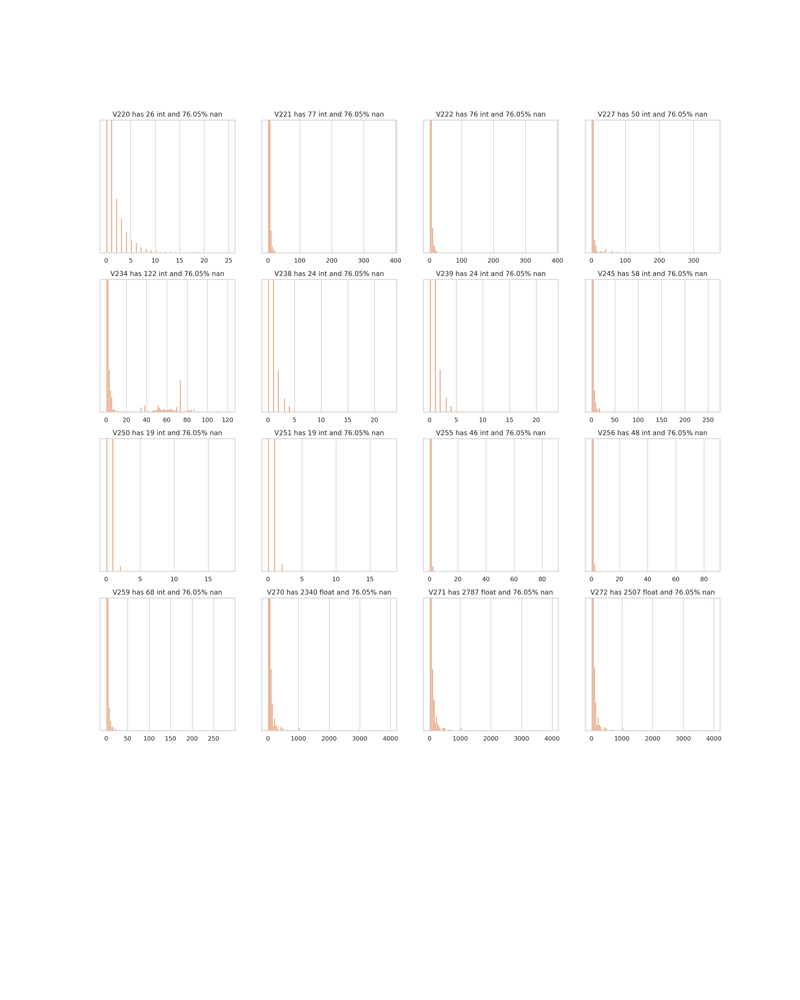

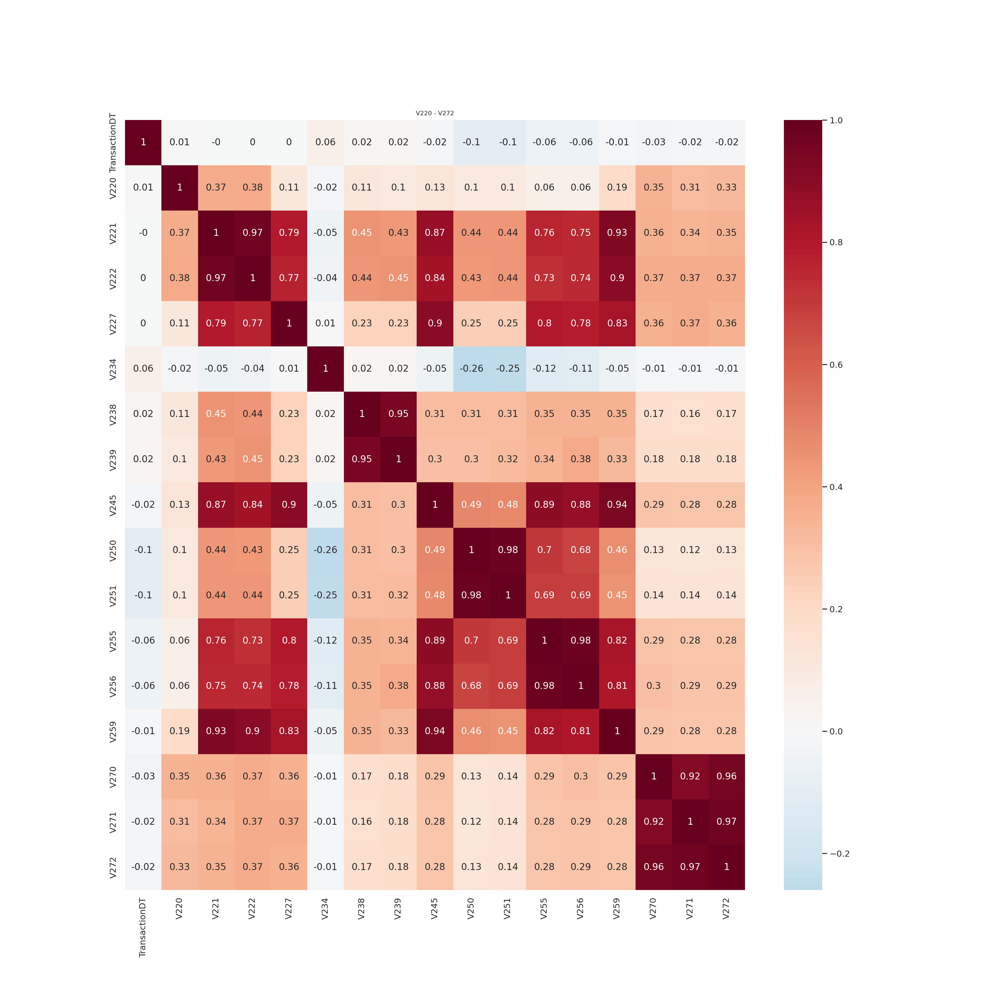

In [ ]:
Vs = nans_groups[449124]
make_plots(Vs)
make_corr(Vs)

In [ ]:
grps = [[220],[221,222,227,245,255,256,259],[234],[238,239],[250,251],[270,271,272]]
reduce_group(grps)

Use these [220, 221, 234, 238, 250, 271]


- 결측치가 449124개인 그룹중에서 고유값이 많은 피처들
- V [220, 221, 234, 238, 250, 271]
---

### V281 ~ V315, D1

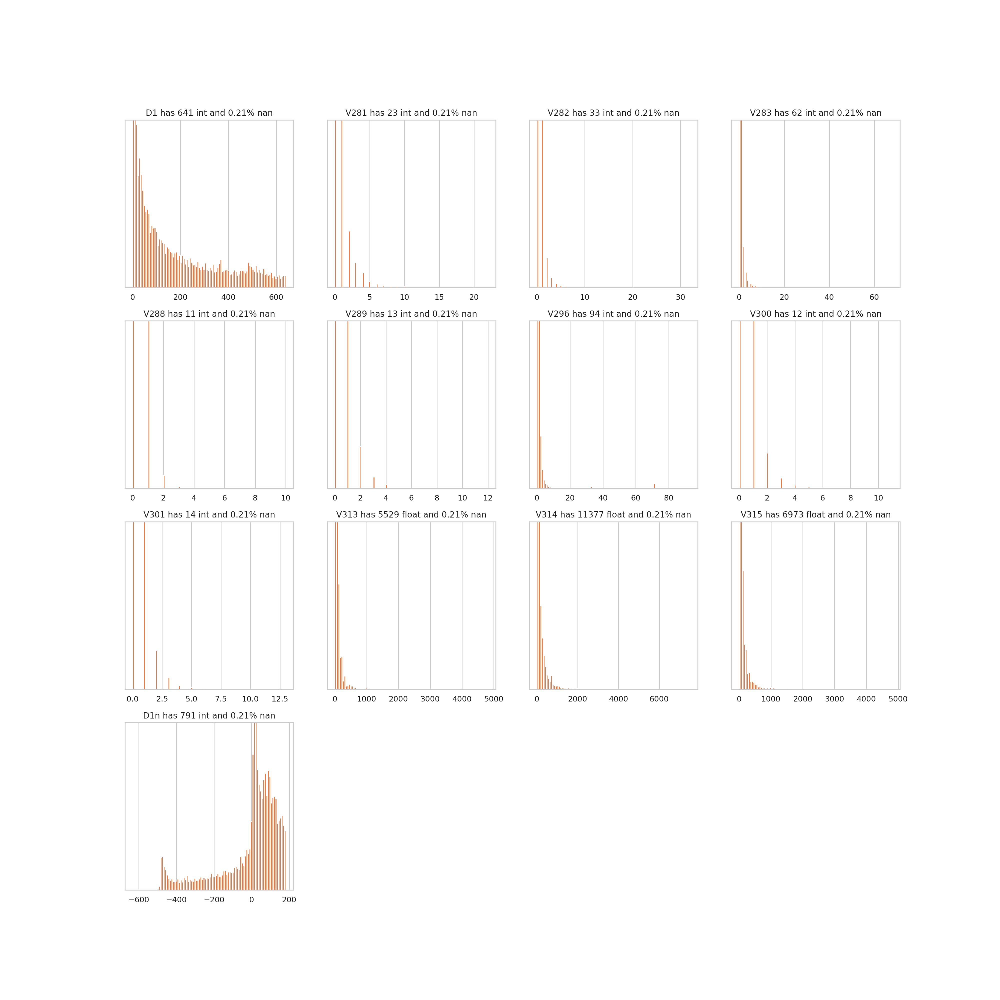

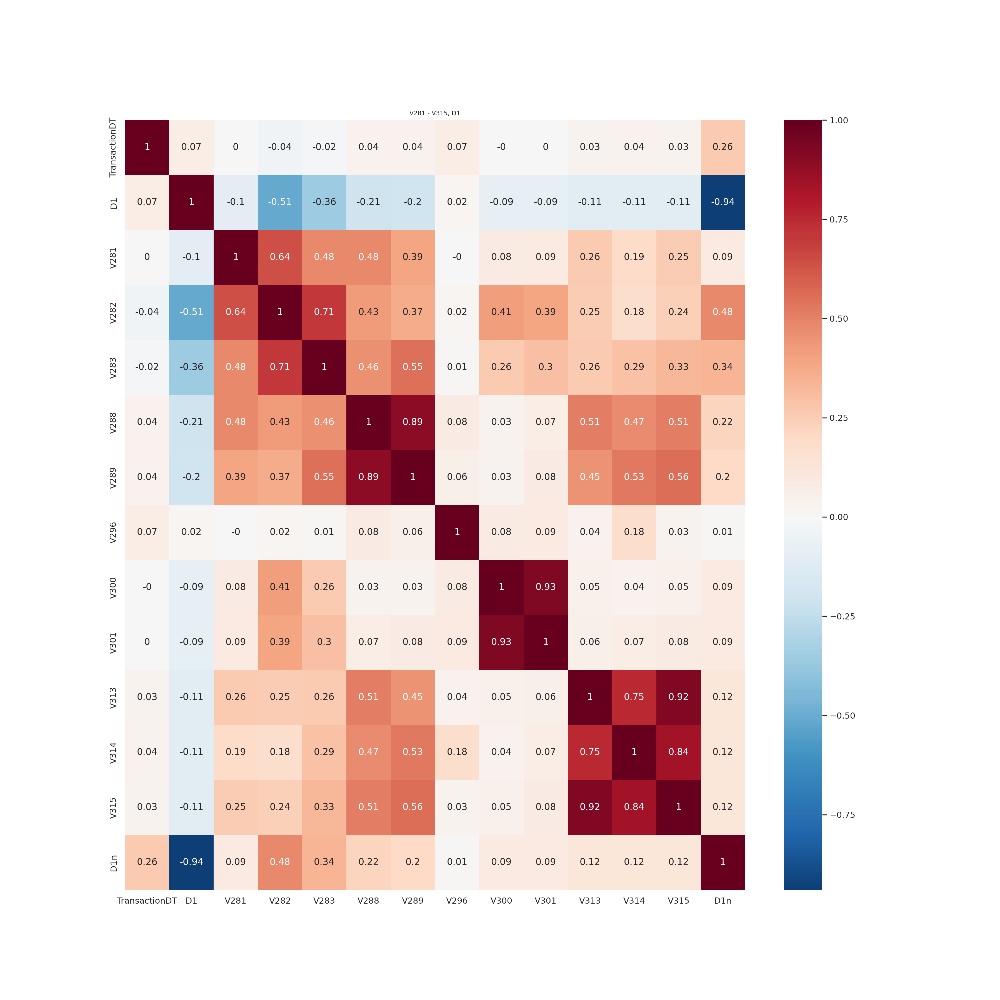

In [ ]:
Vs = nans_groups[1269]
make_plots(Vs)
Vtitle = 'V281 - V315, D1'
make_corr(Vs,Vtitle)

In [ ]:
grps = [[281],[282,283],[288,289],[296],[300,301],[313,314,315]]
reduce_group(grps)

Use these [281, 283, 289, 296, 301, 314]


- 결측치가 1269개인 그룹중에서 고유값이 많은 피처들
- V [281, 283, 289, 296, 301, 314]
---

### V322 - V339

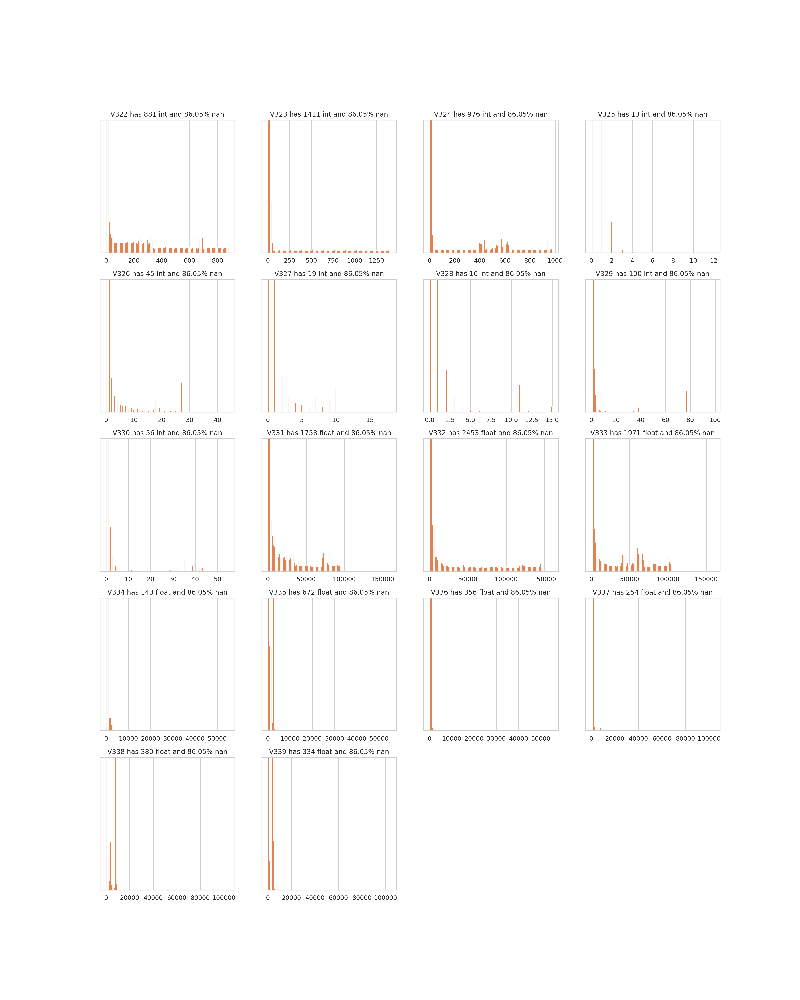

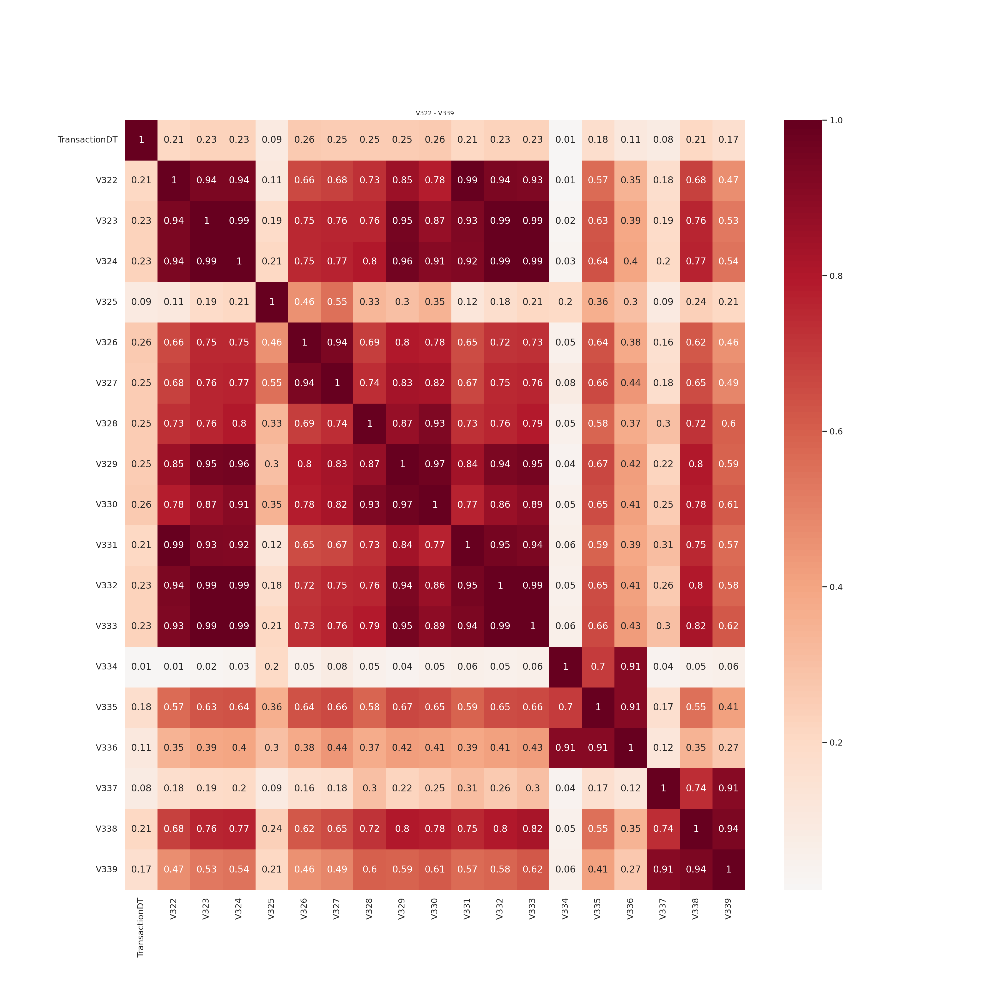

In [ ]:
Vs = nans_groups[508189]
make_plots(Vs)
make_corr(Vs)

In [ ]:
grps = [[322,323,324,326,327,328,329,330,331,332,333],[325],[334,335,336],[337,338,339]]
reduce_group(grps)

Use these [332, 325, 335, 338]


- 결측치 508189개인 그룹중에서 고유값이 많은 피처들
- V [332, 325, 335, 338]

### V All

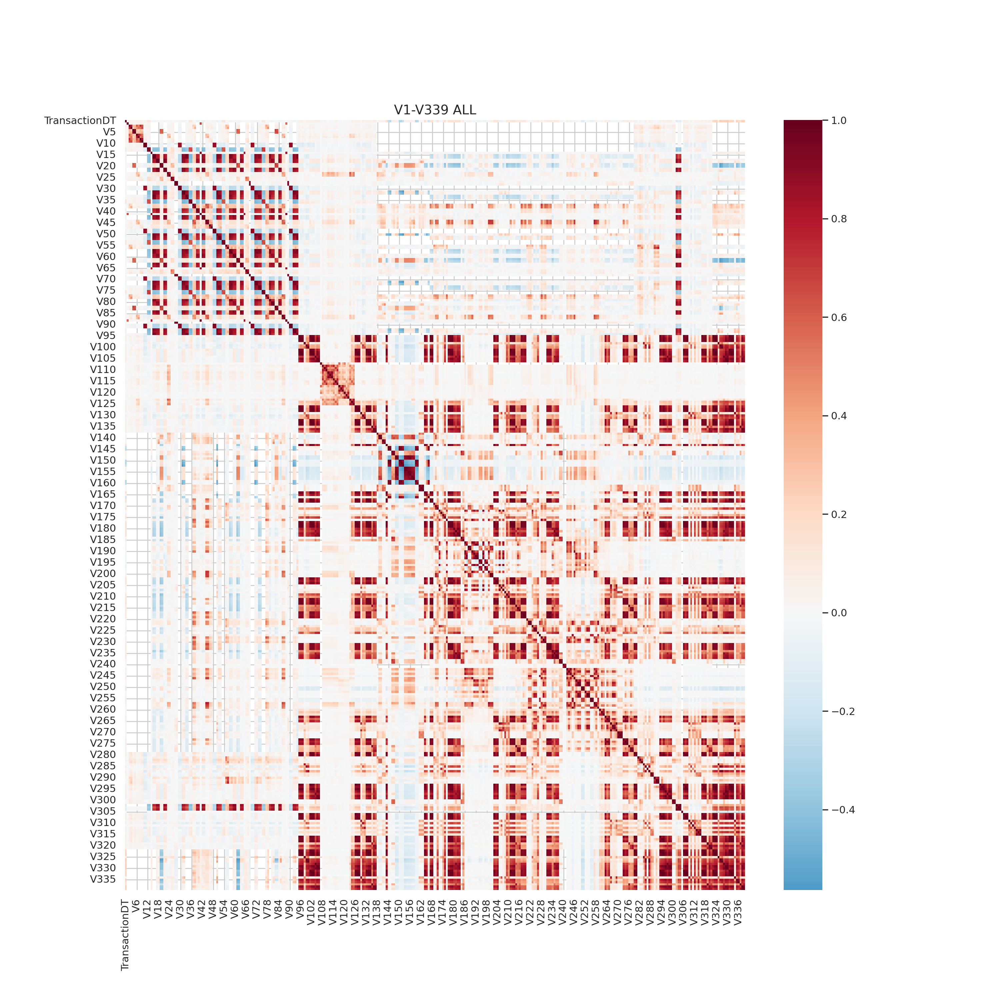

In [ ]:
# 'TransactionDT' 컬럼을 리스트에 추가, 'V1'부터 'V339'까지의 컬럼명을 생성하고, 이를 리스트로 만듭니다.
cols = ['TransactionDT'] + ['V'+str(x) for x in range(1,340)]
# 데이터 20프로를 무작위로 샘플링
train2 = train_df[cols].sample(frac=0.2)
plt.figure(figsize=(15,15))

# cmap='RdBu_r': 히트맵의 색상 맵(colormap)을 'Red-Blue reversed'로 설정합니다. 이는 양의 상관관계는 파란색으로, 음의 상관관계는 빨간색으로 표시하는 색상 맵입니다.
# annot=False: 히트맵에 상관계수 값을 표시하지 않습니다.
# center=0.0: 상관계수 0을 기준으로 색상을 중심에 두도록 설정합니다. 즉, 0에 해당하는 색상을 중립색(보통 흰색)으로 설정합니다.
sns.heatmap(train2[cols].corr(), cmap='RdBu_r', annot=False, center=0.0)

plt.title('V1-V339 ALL',fontsize=14)
plt.show()

### V Reduced

In [ ]:
v =  [1, 3, 4, 6, 8, 11]
v += [13, 14, 17, 20, 23, 26, 27, 30]
v += [36, 37, 40, 41, 44, 47, 48]
v += [54, 56, 59, 62, 65, 67, 68, 70]
v += [76, 78, 80, 82, 86, 88, 89, 91]
v += [96, 98, 99, 104]
v += [107, 108, 111, 115, 117, 120, 121, 123]
v += [124, 127, 129, 130, 136]
v += [138, 139, 142, 147, 156, 162]
v += [165, 160, 166]
v += [178, 176, 173, 182]
v += [187, 203, 205, 207, 215]
v += [169, 171, 175, 180, 185, 188, 198, 210, 209]
v += [218, 223, 224, 226, 228, 229, 235]
v += [240, 258, 257, 253, 252, 260, 261]
v += [264, 266, 267, 274, 277]
v += [220, 221, 234, 238, 250, 271]
v += [294, 284, 285, 286, 291, 297]
v += [303, 305, 307, 309, 310, 320]
v += [281, 283, 289, 296, 301, 314]
v += [332, 325, 335, 338]

- 위에 고유값들이 많은 피처들을 골랐던걸 넣어줌

In [ ]:
print('Reduced set has',len(v),'columns')

Reduced set has 128 columns


- 최종적으로 128개의 변수를 선택
- 다중 공선성(multicollinearity) 제거: 전체 데이터셋에는 많은 변수가 포함되어 있으며, 이들 중 일부는 서로 강한 상관관계를 가질 수 있습니다. 이는 다중 공선성 문제를 야기하여 모델의 성능을 저하시킬 수 있습니다. 이를 피하기 위해 상관관계 분석을 통해 선택된 변수를 사용하여 모델의 성능을 최적화
- 연산 속도 향상: 변수의 수가 줄어들면, 연산 속도가 빨라지고 메모리 사용량도 감소합니다. 이는 모델 학습 시간과 예측 시간을 줄여줍니다.
- 메모리 절약: 변수 수를 줄이면 메모리 사용량이 감소하여, 더 큰 데이터셋을 처리할 수 있습니다.
- 과적합 방지: 변수의 수를 줄이면 모델이 과적합(overfitting)되는 것을 방지할 수 있습니다. 불필요한 변수들을 제거함으로써 모델이 데이터의 노이즈에 적응하는 것을 방지하고, 일반화 성능을 향상시킬 수 있습니다.
- 중요 변수만 사용: 상관관계 분석을 통해 중요한 변수들만 선택하여 모델의 성능을 최적화할 수 있습니다.

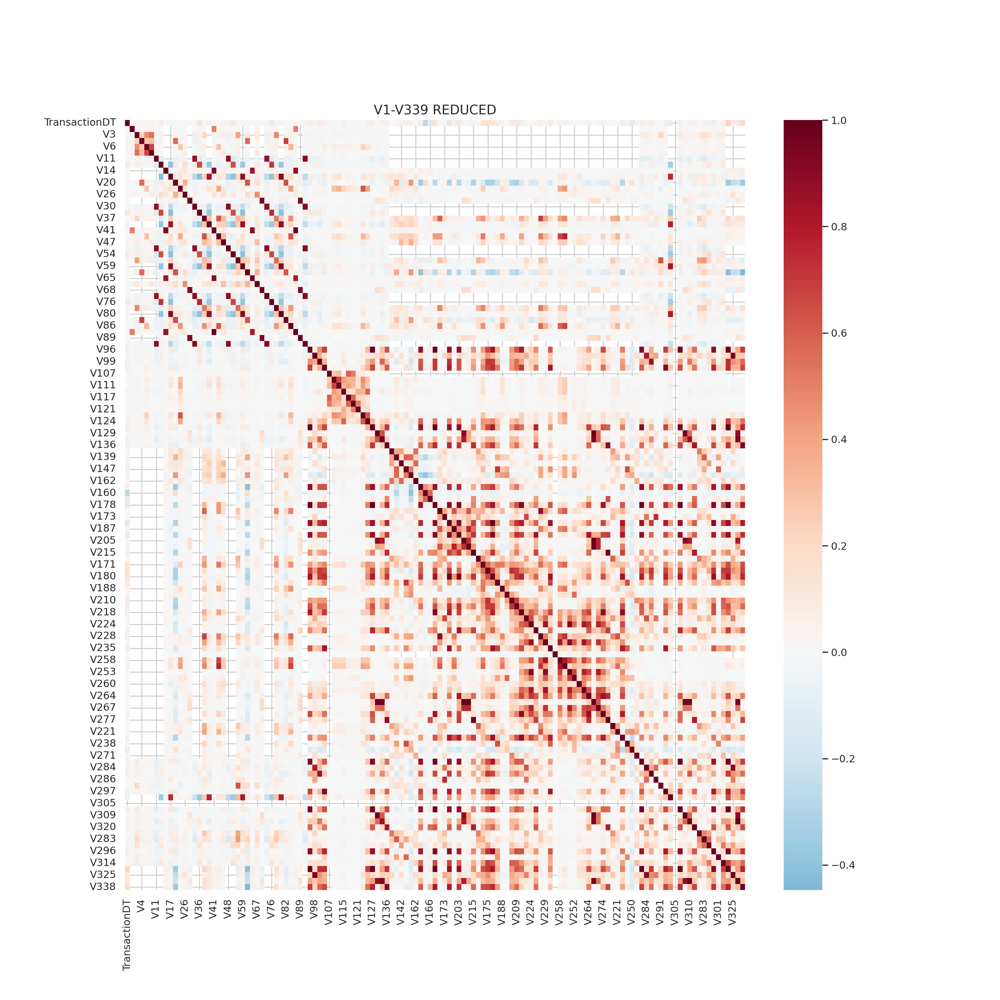

In [ ]:
cols = ['TransactionDT'] + ['V'+str(x) for x in v]
train2 = train_df[cols].sample(frac=0.2)
plt.figure(figsize=(15,15))
sns.heatmap(train2[cols].corr(), cmap='RdBu_r', annot=False, center=0.0)
plt.title('V1-V339 REDUCED',fontsize=14)
plt.show()

- v [1, 3, 4, 6, 8, 11]  (결측치 279,287개)
- v [13, 14, 17, 20, 23, 26, 27, 30] (결측치 76,073개)
- v [36, 37, 40, 41, 44, 47, 48] (결측치 168,969개)
- v [54, 56, 59, 62, 65, 67, 68, 70] (결측치 77,096개)
- v [76, 78, 80, 82, 86, 88, 89, 91] (결측치 89,164)
- v [96, 98, 99, 104] (결측치 314개)
- v [107, 108, 111, 115, 117, 120, 121, 123] (결측치 314개)
- v [124, 127, 129, 130, 136] (결측치 314개)
- v [138, 139, 142, 147, 156, 162] (결측치 508,595개)
- v [165, 160, 166] (결측치 508,589개)
- v [178, 176, 173, 182] (결측치 450,909개)
- v [187, 203, 205, 207, 215] (결측치 450,909개)
- v [169, 171, 175, 180, 185, 188, 198, 210, 209] (결측치 450,721개)
- v [218, 223, 224, 226, 228, 229, 235] (결측치 460,110개)
- v [240, 258, 257, 253, 252, 260, 261] (결측치 460,110개)
- v [264, 266, 267, 274, 277] (결측치 460,110개)
- v [220, 221, 234, 238, 250, 271] (결측치 449,124개)
- v [294, 284, 285, 286, 291, 297] (결측치 12개)
- v [303, 305, 307, 309, 310, 320] (결측치 12개)
- v [281, 283, 289, 296, 301, 314] (결측치 1,269개)
- v [332, 325, 335, 338] (결측치 508,189개)

- 128개 고른 변수들로 히트맵
- 선택된 128개의 변수를 사용한 히트맵은 이전 분석을 통해 중요하거나 상관관계가 높은 변수들만 포함하고 있습니다.
- 노이즈가 줄어들고, 더 명확하게 상관관계를 볼 수 있습니다.
- 변수 선택 과정이 유의미했다면, 중요한 상관관계는 유지되고, 불필요한 상관관계는 제거되었을 것입니다.